# Assgnment 3 - Unsupervised Learning
# Bank Marketing Dataset
## student: hyao66

In [54]:
# import library
import csv
import pandas as pd
import matplotlib.pyplot as plt
import sklearn as sk
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
import seaborn as sns
import numpy as np
import time

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.decomposition import FastICA
from sklearn.random_projection import GaussianRandomProjection,SparseRandomProjection, johnson_lindenstrauss_min_dim
from sklearn.feature_selection import RFE
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.cm as cm

### load dataset and EDA
bank marketing dataset from UCI Machine Learning Repository

17 independent variables

dependent variable - has the client subscribed a term deposit, yes / no

URL for the dataset:
https://archive.ics.uci.edu/ml/datasets/Bank+Marketing

In [2]:
# read data
raw = pd.read_csv('bank_marketing.csv', sep = ';')
raw.dtypes

age           int64
job          object
marital      object
education    object
default      object
balance       int64
housing      object
loan         object
contact      object
day           int64
month        object
duration      int64
campaign      int64
pdays         int64
previous      int64
poutcome     object
y            object
dtype: object

<AxesSubplot:xlabel='y', ylabel='count'>

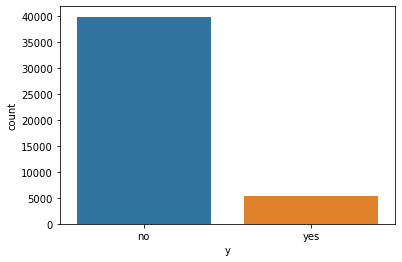

In [3]:
# Plot y
sns.countplot(x="y",data=raw)

In [4]:
# label encoding for categorical data

# label encoding for categorical data
raw['job'].astype('category')
raw['marital'].astype('category')
raw['education'].astype('category')
raw['default'].astype('category')
raw['housing'].astype('category')
raw['loan'].astype('category')
raw['contact'].astype('category')
raw['month'].astype('category')
raw['poutcome'].astype('category')
le = preprocessing.LabelEncoder()
raw['job_Cat'] = le.fit_transform(raw['job'])
raw['marital_Cat'] = le.fit_transform(raw['marital'])
raw['education_Cat'] = le.fit_transform(raw['education'])
raw['default_Cat'] = le.fit_transform(raw['default'])
raw['housing_Cat'] = le.fit_transform(raw['housing'])
raw['loan_Cat'] = le.fit_transform(raw['loan'])
raw['contact_Cat'] = le.fit_transform(raw['contact'])
raw['month_Cat'] = le.fit_transform(raw['month'])
raw['poutcome_Cat'] = le.fit_transform(raw['poutcome'])

In [5]:
raw = raw.dropna()

In [6]:
# train test split
# split data into training and testing sets
# Split the data into training and testing sets
raw_cat = raw.drop(["job","marital","education","default","housing","loan","contact","month","poutcome"], axis = 1)


features = raw_cat.drop(['y'], axis = 1)
feature_list = list(features.columns)
features_np = np.array(features)

labels = raw_cat[['y']]
labels_np = np.array(labels)[:,0]

label_unique = list(set(labels_np))

train_features, test_features, train_labels, test_labels = train_test_split(features_np, labels_np, test_size = 0.20, 
                                                                            random_state = 42)

print(feature_list)
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)


# normalize x
scaler = MinMaxScaler()
features = scaler.fit_transform(features_np)
train_features = scaler.fit_transform(train_features)
test_features = scaler.transform(test_features)

['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous', 'job_Cat', 'marital_Cat', 'education_Cat', 'default_Cat', 'housing_Cat', 'loan_Cat', 'contact_Cat', 'month_Cat', 'poutcome_Cat']
Training Features Shape: (36168, 16)
Training Labels Shape: (36168,)
Testing Features Shape: (9043, 16)
Testing Labels Shape: (9043,)


#### Utility functions

In [7]:
def distortion(X, n_cluster, model):
    ncluster = np.arange(2, n_cluster)
    inertia = []
    for acluster in ncluster:
        clf=model(acluster, random_state=42).fit(X) 
        inertia.append(clf.inertia_)
    inertia = np.array(inertia)
    plt.plot(ncluster,inertia, marker='o')
    plt.xticks(np.arange(min(ncluster), max(ncluster)+1, 1.0))
    plt.xlabel('Number of Clusters')
    plt.ylabel('Distortion')
    plt.title('Choosing Best k with Inertia - Bank Marketing')
    plt.show()
    
def silhoutte(X, n_cluster, model):
#     https://www.analyticsvidhya.com/blog/2021/05/k-mean-getting-the-optimal-number-of-clusters/
    ncluster = np.arange(2, n_cluster)
    silhouette_avg = []
    for acluster in ncluster:
        clf=model(acluster, random_state=42).fit(X) 
#         cluster_labels = clf.labels_
        cluster_labels=clf.predict(X)
        # silhouette score
        silhouette_avg.append(silhouette_score(X, cluster_labels))
              
    plt.plot(ncluster,silhouette_avg,'bx-')
    plt.xlabel('Number of Clusters') 
    plt.xticks(np.arange(min(ncluster), max(ncluster)+1, 1.0))
    plt.ylabel('Silhouette score') 
    plt.title('Choosing Best k with Silhouette score - Bank Marketing')
    plt.show()
    
    
def silhoutte_plot(X, n_cluster, model):
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
    ncluster = np.arange(2, n_cluster)
#     print(model)
    for acluster in ncluster:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (acluster + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 42 for reproducibility.
        clf=model(acluster, random_state=42).fit(X) 
#         cluster_labels = clf.labels_
        cluster_labels=clf.predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print(
            "For n_clusters =",
            acluster,
            "The average silhouette_score is :",
            silhouette_avg,
        )

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(acluster):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / acluster)
            ax1.fill_betweenx(
                np.arange(y_lower, y_upper),
                0,
                ith_cluster_silhouette_values,
                facecolor=color,
                edgecolor=color,
                alpha=0.7,
            )

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / acluster)
        ax2.scatter(
            X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
        )

        # Labeling the clusters
        if clf.__module__ =='sklearn.cluster._kmeans':
#             print(model)
            centers = clf.cluster_centers_
        else:
            centers = clf.means_
        # Draw white circles at cluster centers
        ax2.scatter(
            centers[:, 0],
            centers[:, 1],
            marker="o",
            c="white",
            alpha=1,
            s=200,
            edgecolor="k",
        )

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(
            "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d for bank marketing" 
            % acluster,
            fontsize=14,
            fontweight="bold",
        )

    plt.show()

    
def EM_BIC (X, n_cluster):
#     https://towardsdatascience.com/gaussian-mixture-model-clusterization-how-to-select-the-number-of-components-clusters-553bef45f6e4
    ncluster = np.arange(2, n_cluster)
    bics=[]
    bics_err=[]
    random=20
    for acluster in ncluster:
        tmp_bic=[]
        for randomstate in range(random):
            clf=GaussianMixture(acluster, random_state=randomstate).fit(X) 
            tmp_bic.append(clf.bic(X))
        val=np.mean(tmp_bic)
        err=np.std(tmp_bic)
        bics.append(val)
        bics_err.append(err)

    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
        
    ax1.errorbar(ncluster,bics, yerr=bics_err, label='BIC')
    ax1.set_title("BIC Scores")
    ax1.set_xticks(ncluster)
    ax1.set_xlabel("Number of Clusters")
    ax1.set_ylabel("BIC")

    ax2.errorbar(ncluster, np.gradient(bics), yerr=bics_err, label='BIC')
    ax2.set_title("Gradient of BIC Scores")
    ax2.set_xticks(ncluster)
    ax2.set_xlabel("Number of Clusters")
    ax2.set_ylabel("grad(BIC)")

###### K Means

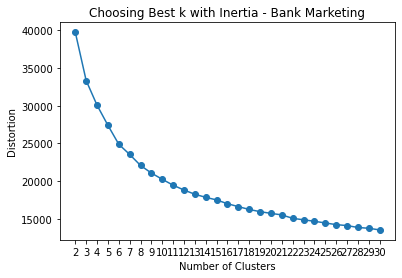

In [8]:
distortion(features, 31, KMeans)

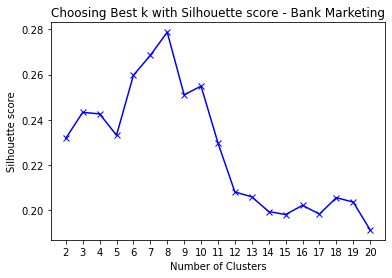

In [9]:
silhoutte(features, 21, KMeans)

For n_clusters = 2 The average silhouette_score is : 0.23185604624666176
For n_clusters = 3 The average silhouette_score is : 0.2433019559468345
For n_clusters = 4 The average silhouette_score is : 0.24264415174446624
For n_clusters = 5 The average silhouette_score is : 0.23320740273662843
For n_clusters = 6 The average silhouette_score is : 0.2597025529312461
For n_clusters = 7 The average silhouette_score is : 0.26849984296050705
For n_clusters = 8 The average silhouette_score is : 0.2787148966442423
For n_clusters = 9 The average silhouette_score is : 0.25105529299737817
For n_clusters = 10 The average silhouette_score is : 0.25492839895099445
For n_clusters = 11 The average silhouette_score is : 0.22978189151112452


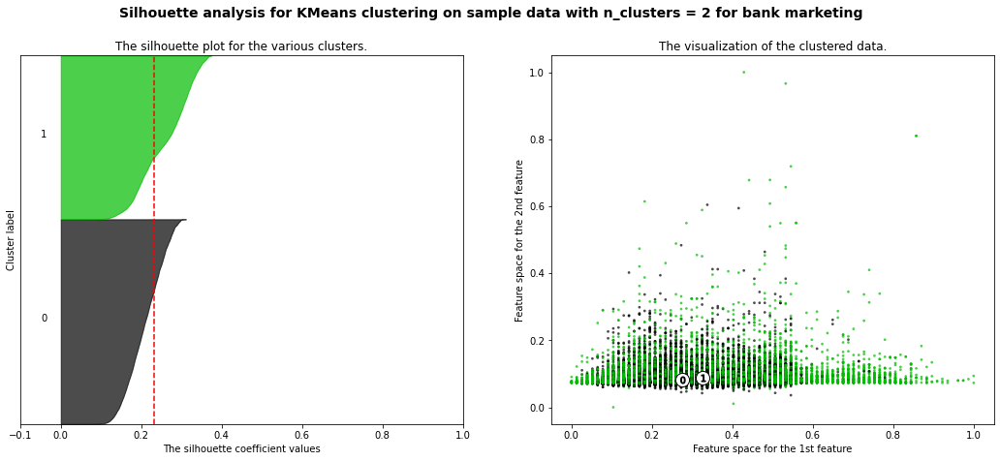

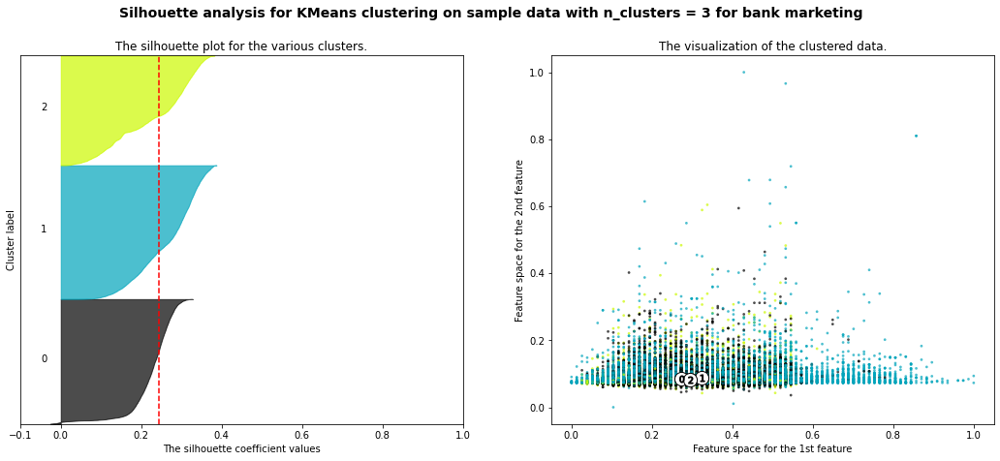

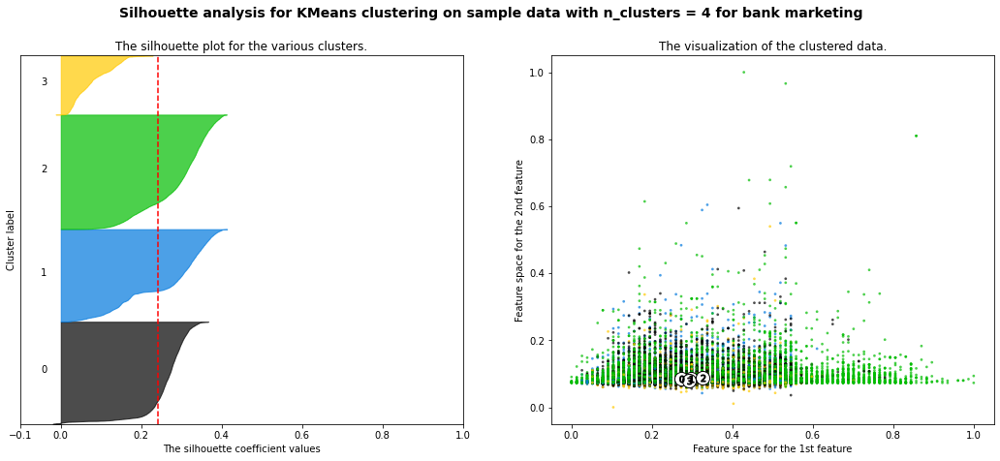

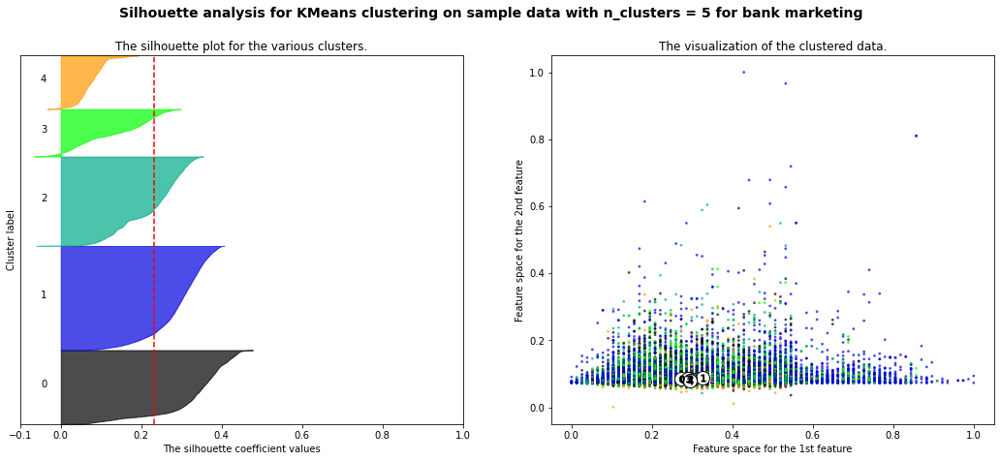

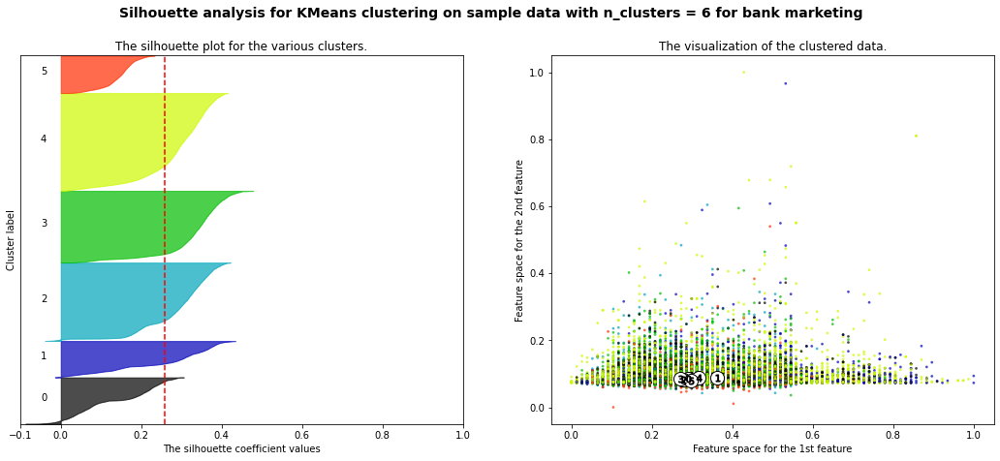

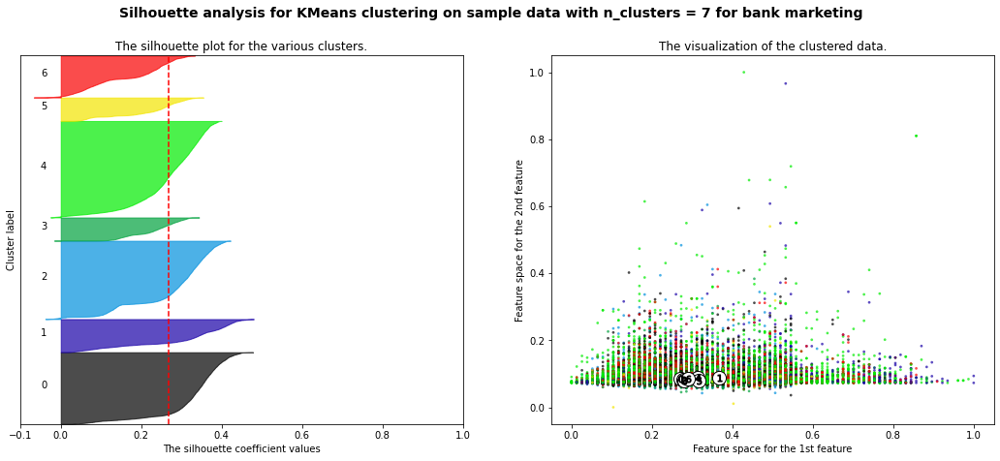

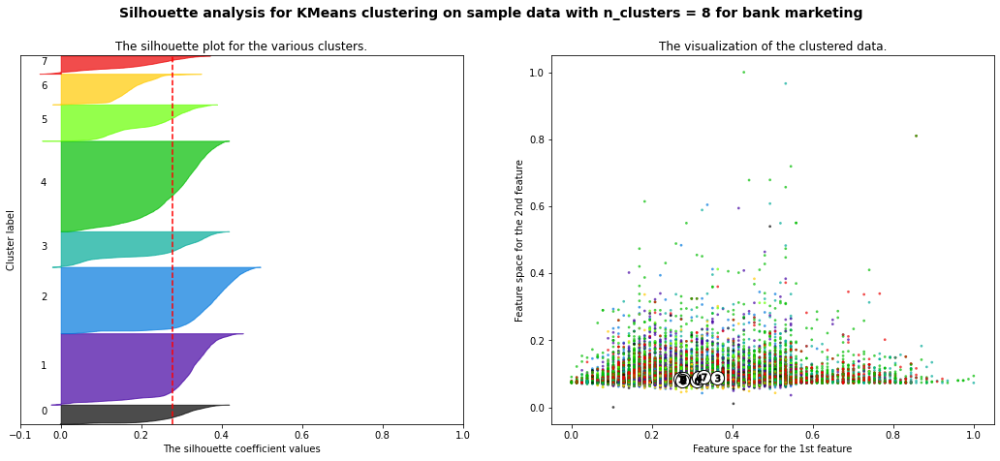

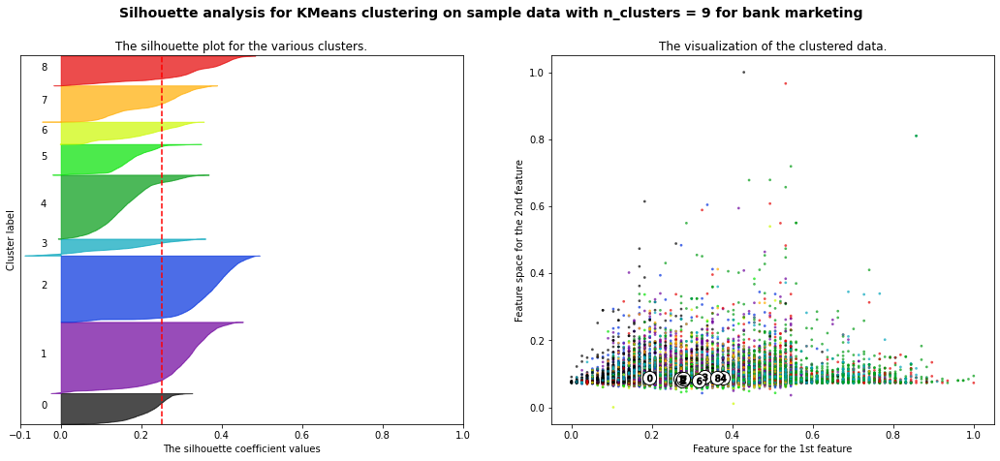

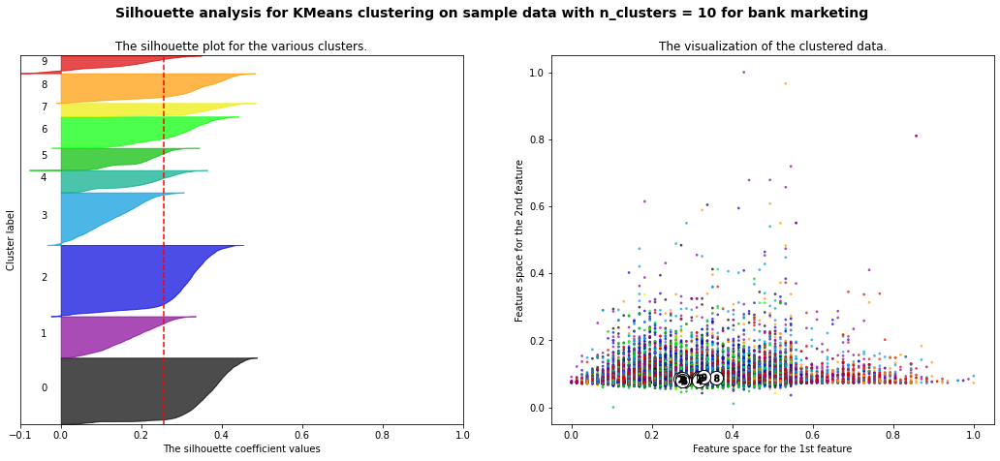

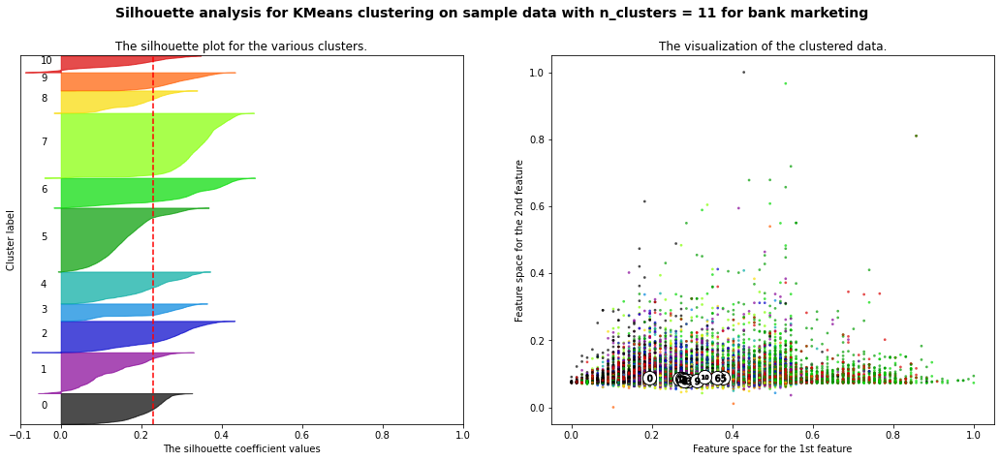

In [10]:
silhoutte_plot(features, 12, KMeans)

In [122]:
clf=KMeans(8, random_state=42).fit(features) 
cluster_labels=clf.predict(features)
cluster_labels = pd.DataFrame(cluster_labels, columns = ['cluster'])
labels = labels.rename(columns = {'y': 'original_label'})
result = labels.join(cluster_labels)
# result = pd.concat([labels, cluster_labels], axis=1)

In [123]:
result['COUNTER'] =1    
group_data = result.groupby(['original_label','cluster'])['COUNTER'].sum() #sum function
print(group_data)

original_label  cluster
no              0          2170
                1          7783
                2          7803
                3          4051
                4          9067
                5          4073
                6          3536
                7          1439
yes             0           197
                1           977
                2           347
                3           319
                4          2048
                5           387
                6           224
                7           790
Name: COUNTER, dtype: int64


###### Expectation Maximization

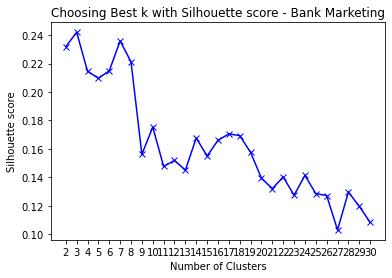

In [11]:
silhoutte(features, 31, GaussianMixture)

For n_clusters = 2 The average silhouette_score is : 0.23185604624666176
For n_clusters = 3 The average silhouette_score is : 0.24199987662405537
For n_clusters = 4 The average silhouette_score is : 0.21458968247618096
For n_clusters = 5 The average silhouette_score is : 0.2096661006862853
For n_clusters = 6 The average silhouette_score is : 0.2149142053412846
For n_clusters = 7 The average silhouette_score is : 0.23590480106205128
For n_clusters = 8 The average silhouette_score is : 0.22121597011181732
For n_clusters = 9 The average silhouette_score is : 0.15619783569478093
For n_clusters = 10 The average silhouette_score is : 0.1753407947809609
For n_clusters = 11 The average silhouette_score is : 0.14769303544919882


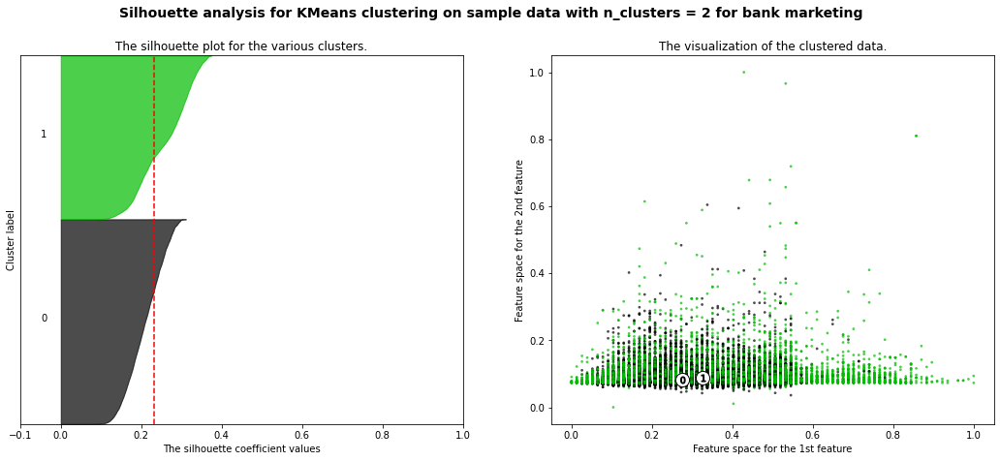

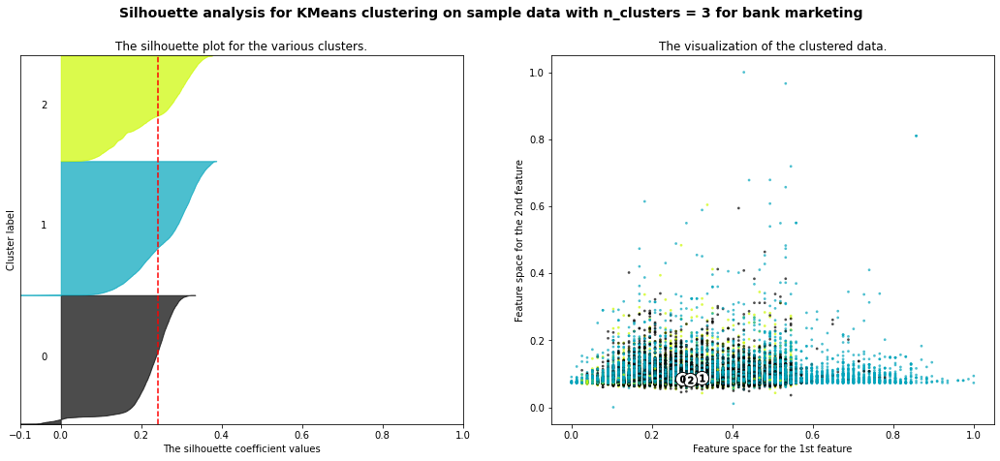

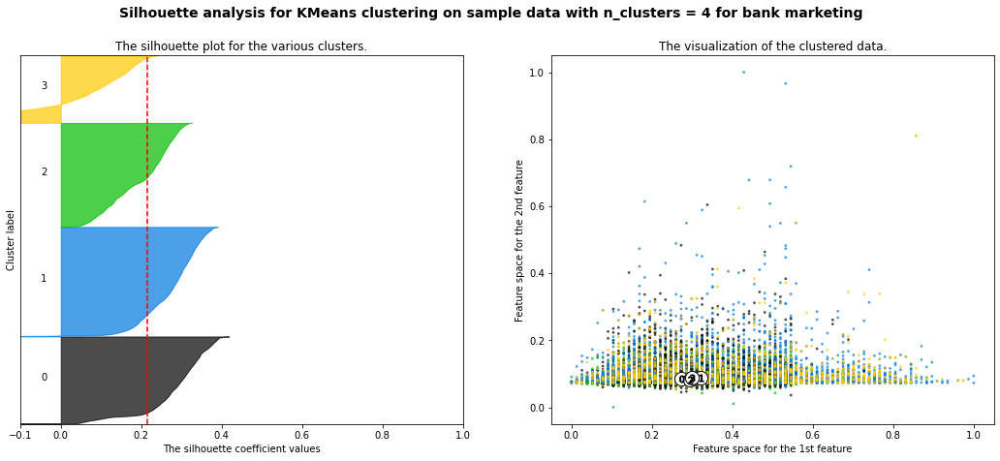

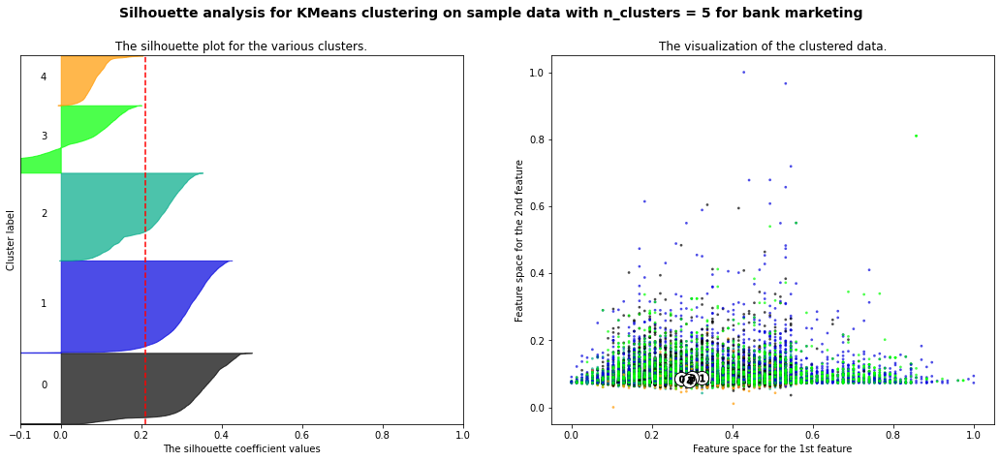

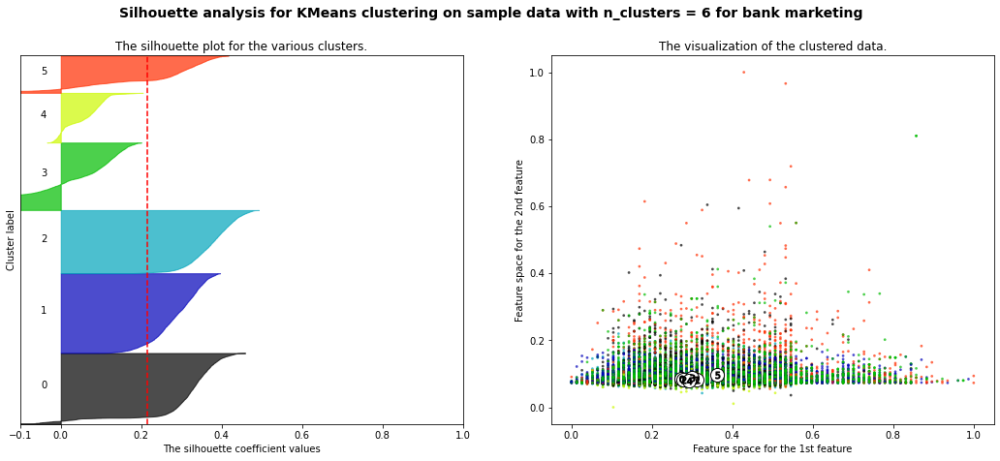

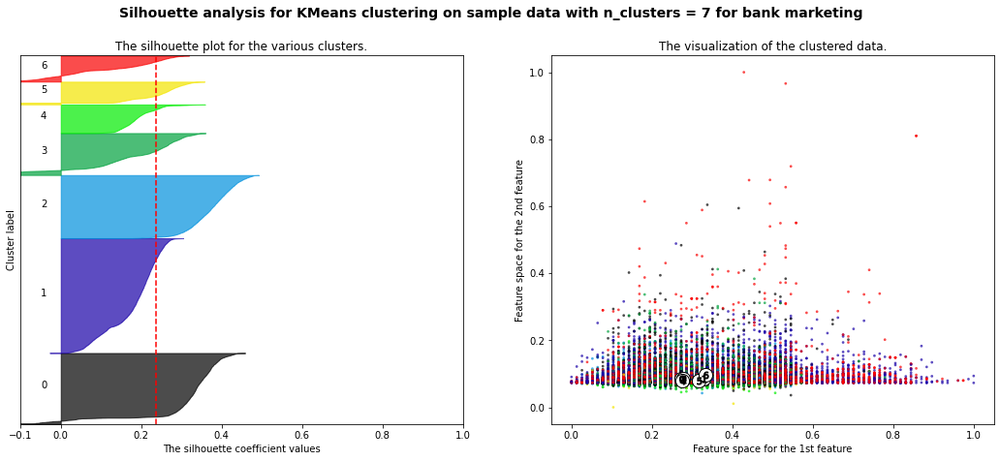

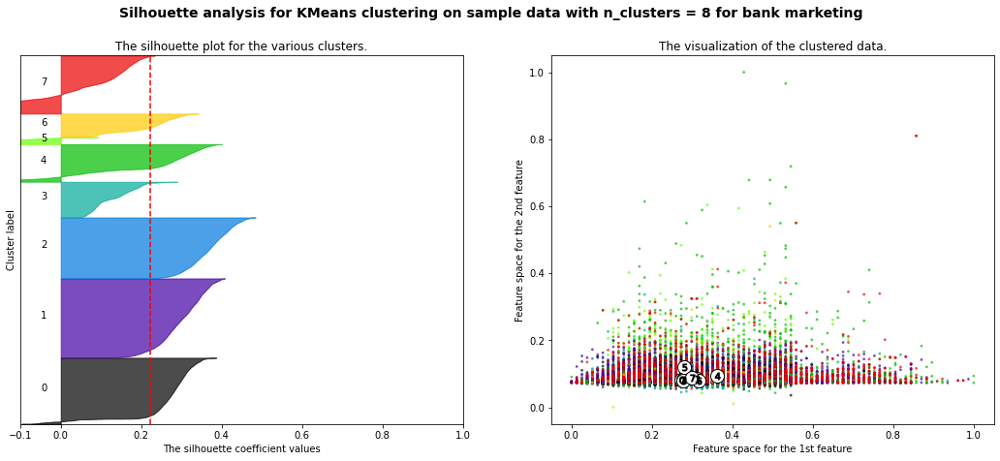

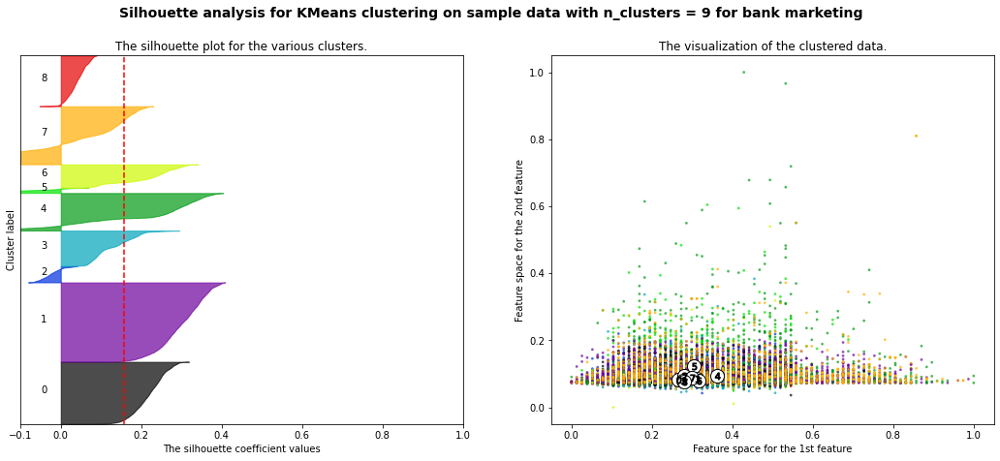

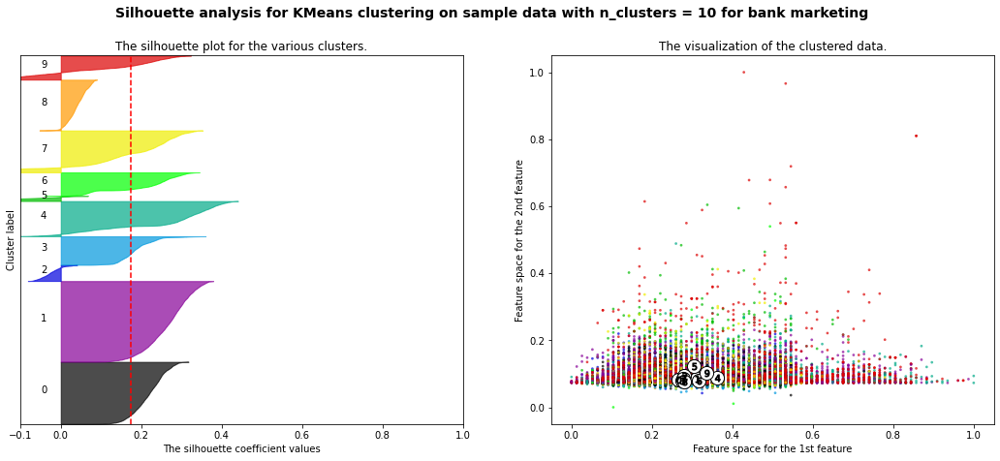

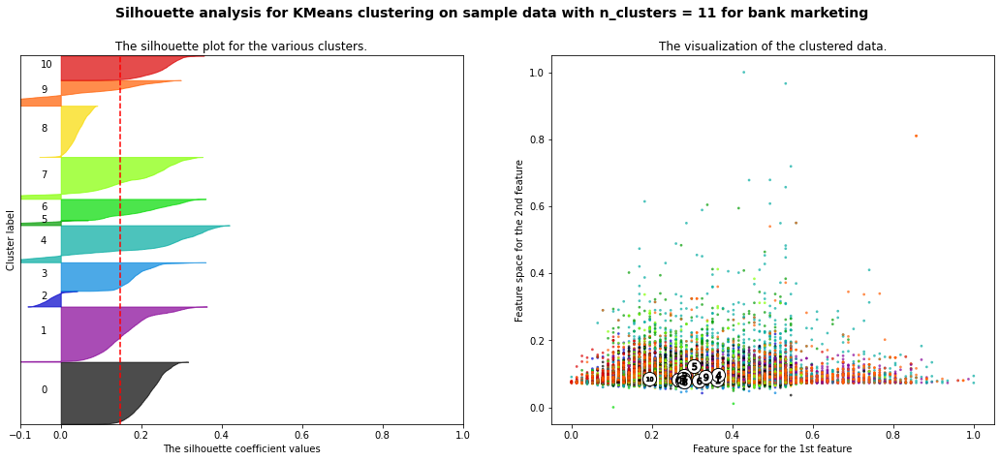

In [12]:
silhoutte_plot(features, 12, GaussianMixture)

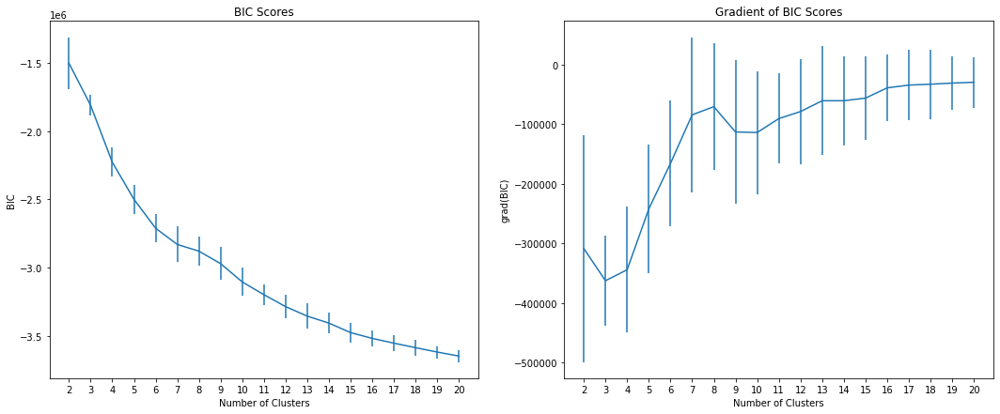

In [13]:
EM_BIC(features, 21)

In [120]:
clf=GaussianMixture(7, random_state=42).fit(features) 
cluster_labels=clf.predict(features)
labels = labels.rename(columns = {'y': 'original_label'})
cluster_labels = pd.DataFrame(cluster_labels, columns = ['cluster'])
result = pd.concat([labels, cluster_labels], axis=1)

In [121]:
result['COUNTER'] =1    
group_data = result.groupby(['original_label','cluster'])['COUNTER'].sum() #sum function
print(group_data)

original_label  cluster
no              0           7935
                1          12191
                2           7440
                3           4499
                4           3321
                5           2603
                6           1933
yes             0            782
                1           1901
                2            314
                3            651
                4            188
                5            187
                6           1266
Name: COUNTER, dtype: int64


###### PCA

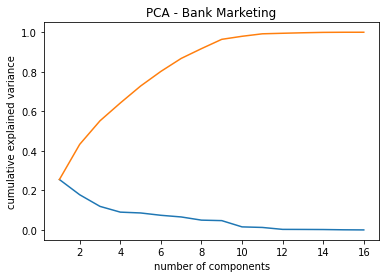

In [14]:
pca = PCA(random_state=42).fit(features)

# https://www.analyticsvidhya.com/blog/2018/08/dimensionality-reduction-techniques-python/
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_)
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), np.cumsum(pca.explained_variance_ratio_))
plt.title("Component-wise and Cumulative Explained Variance")
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title("PCA - Bank Marketing")
plt.show()

In [89]:
eigenvalues = pca.explained_variance_

In [90]:
eigenvalues

array([0.29136583, 0.20326095, 0.13603173, 0.10286415, 0.09806228,
       0.08460158])

In [15]:
## keep about 80% of the variance
pca = PCA(n_components=6, random_state=42)
pca_result = pca.fit_transform(features)
print('PCA Transformed Features Shape:', pca_result.shape)
train_features_PCA, test_features_PCA, train_labels, test_labels = train_test_split(pca_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)
print('PCA Transformed Training Features Shape:', train_features_PCA.shape)
print('Training Labels Shape:', train_labels.shape)
print('PCA Transformed Testing Features Shape:', test_features_PCA.shape)
print('Testing Labels Shape:', test_labels.shape)

PCA Transformed Features Shape: (45211, 6)
PCA Transformed Training Features Shape: (36168, 6)
Training Labels Shape: (36168,)
PCA Transformed Testing Features Shape: (9043, 6)
Testing Labels Shape: (9043,)


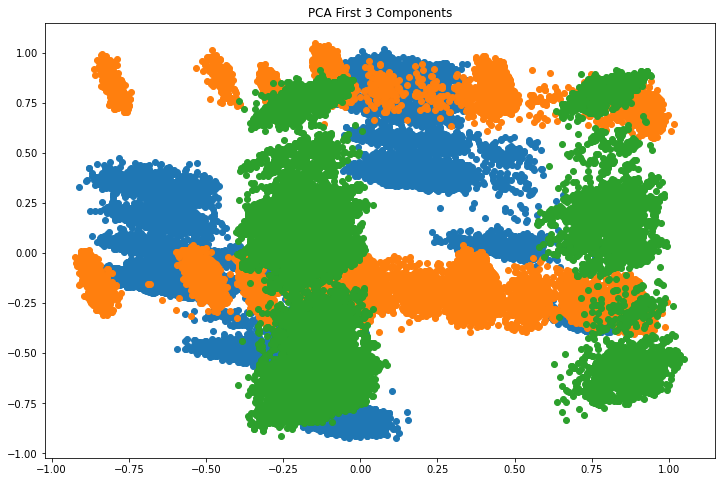

In [16]:
plt.figure(figsize=(12,8))
plt.title('PCA First 3 Components')
plt.scatter(pca_result[:,0], pca_result[:,1])
plt.scatter(pca_result[:,1], pca_result[:,2])
plt.scatter(pca_result[:,2], pca_result[:,0])

0.6776315724767578
0.5860934972806592


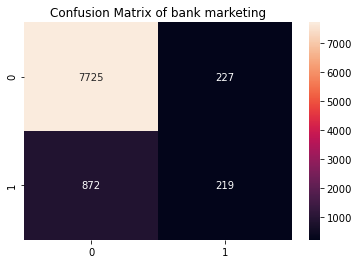

 TestAccuracy
0.8784695344465332


In [17]:
## rerun NN after PCA

MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_PCA, train_labels)


## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_PCA)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_PCA)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

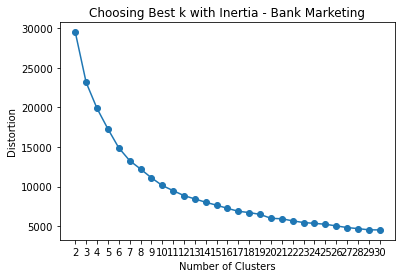

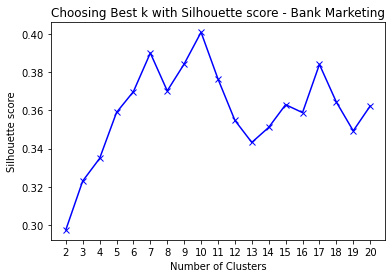

For n_clusters = 2 The average silhouette_score is : 0.2973927272705561
For n_clusters = 3 The average silhouette_score is : 0.3230129407191774
For n_clusters = 4 The average silhouette_score is : 0.3348517846170873
For n_clusters = 5 The average silhouette_score is : 0.3589482947250482
For n_clusters = 6 The average silhouette_score is : 0.36988300264146035
For n_clusters = 7 The average silhouette_score is : 0.3901023293449973
For n_clusters = 8 The average silhouette_score is : 0.3702729366843162
For n_clusters = 9 The average silhouette_score is : 0.3843417958651705
For n_clusters = 10 The average silhouette_score is : 0.4009822644859059
For n_clusters = 11 The average silhouette_score is : 0.37651293791013846
For n_clusters = 12 The average silhouette_score is : 0.3548248534302686
For n_clusters = 13 The average silhouette_score is : 0.343246018390696
For n_clusters = 14 The average silhouette_score is : 0.3511240094746881
For n_clusters = 15 The average silhouette_score is : 0.36

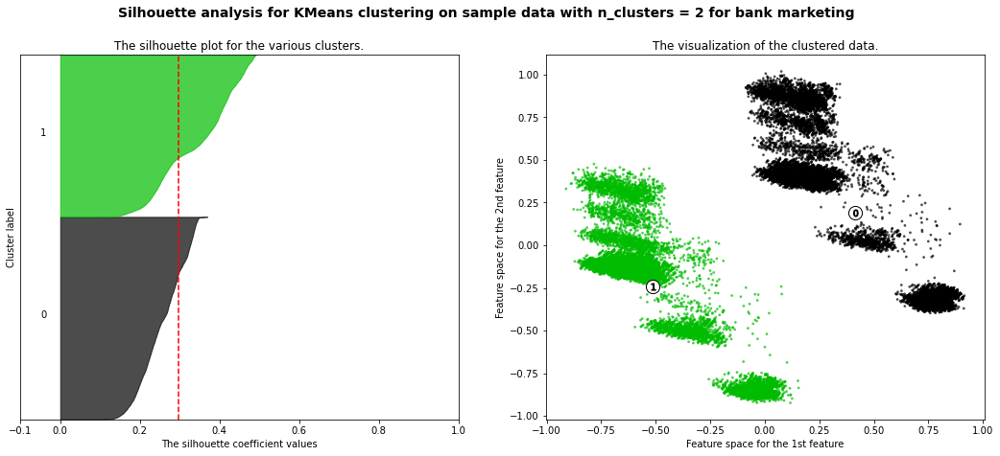

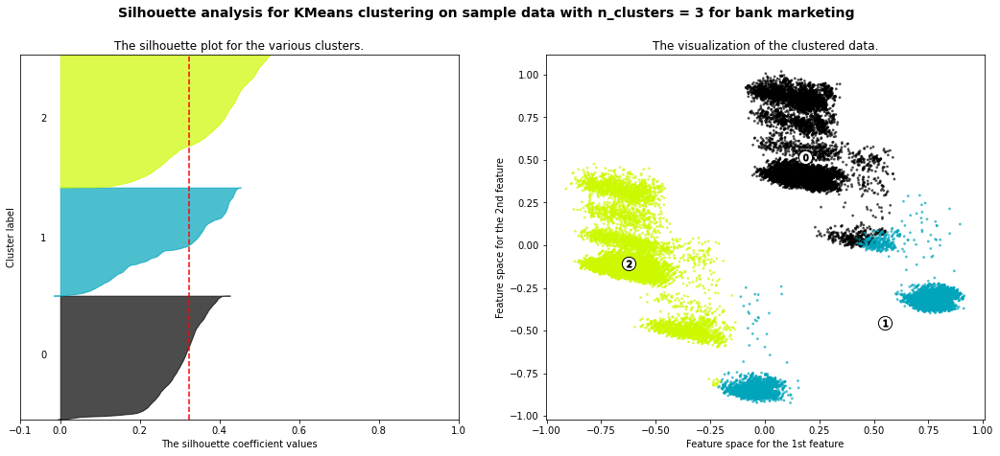

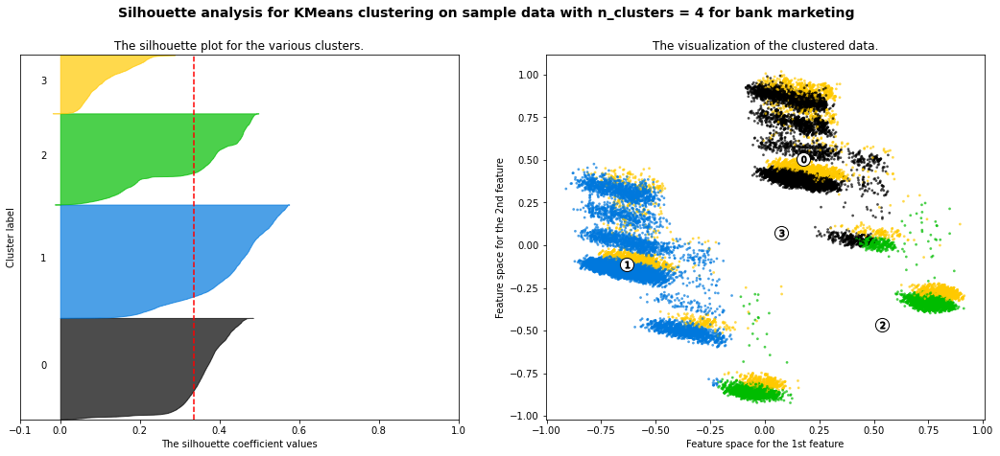

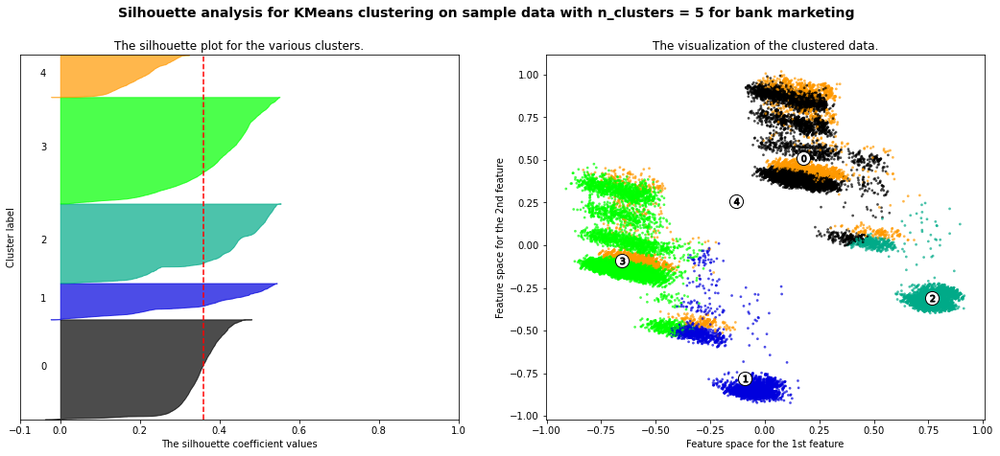

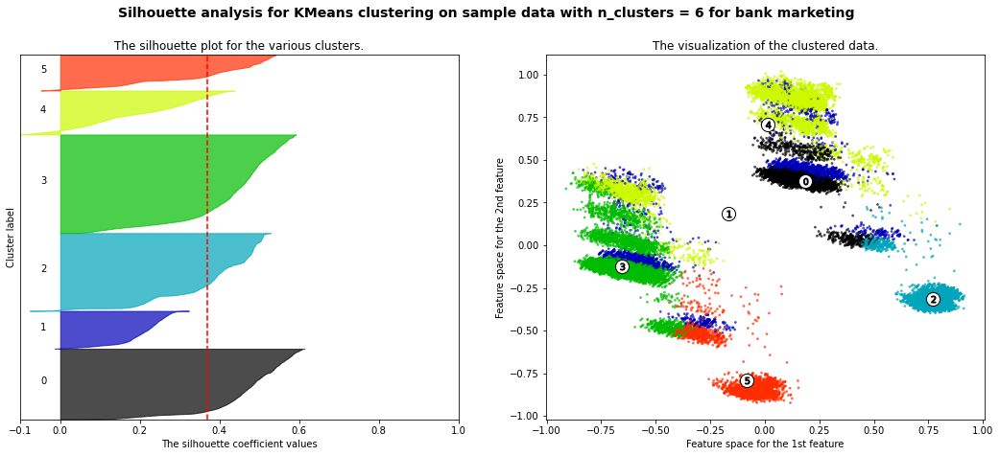

...

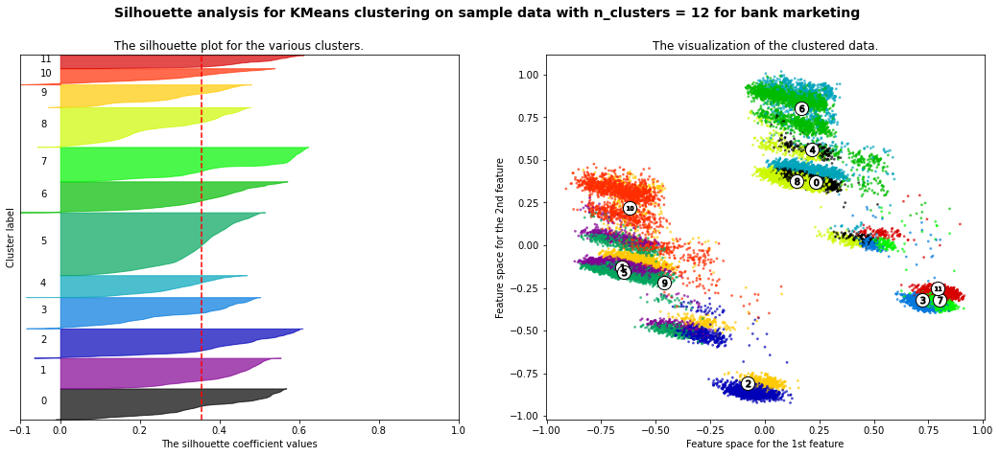

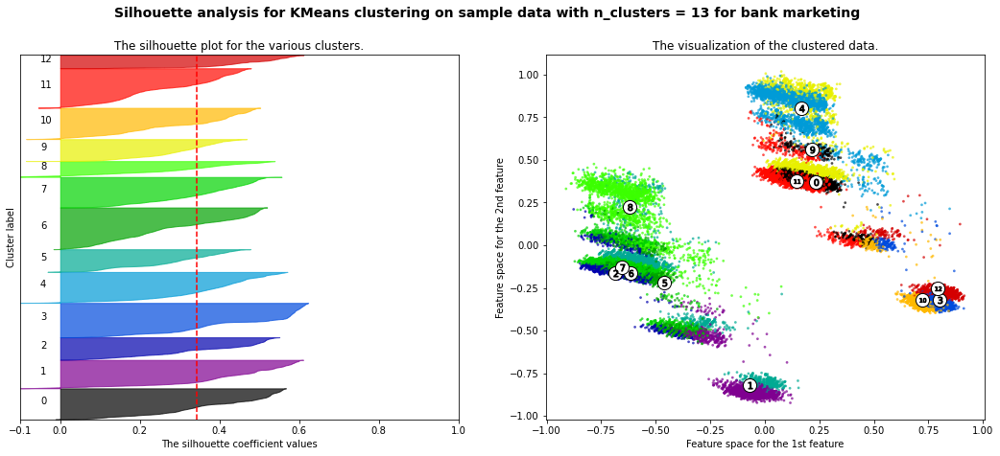

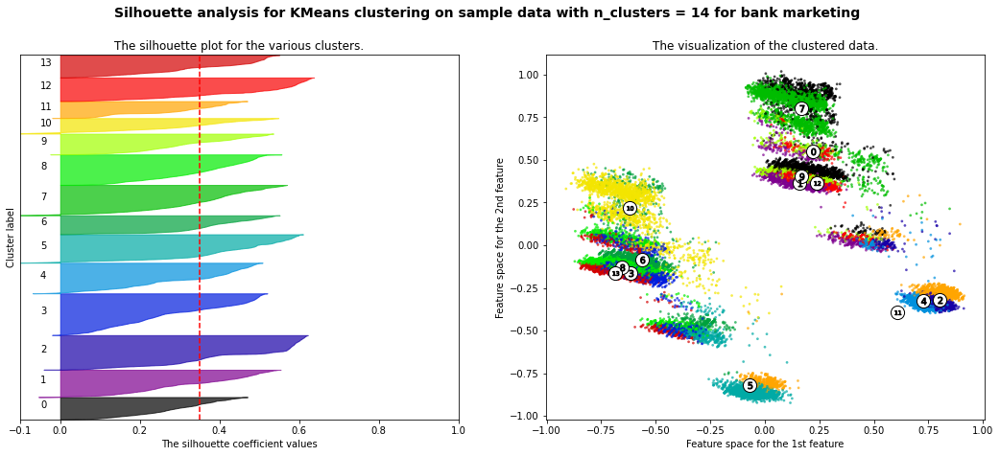

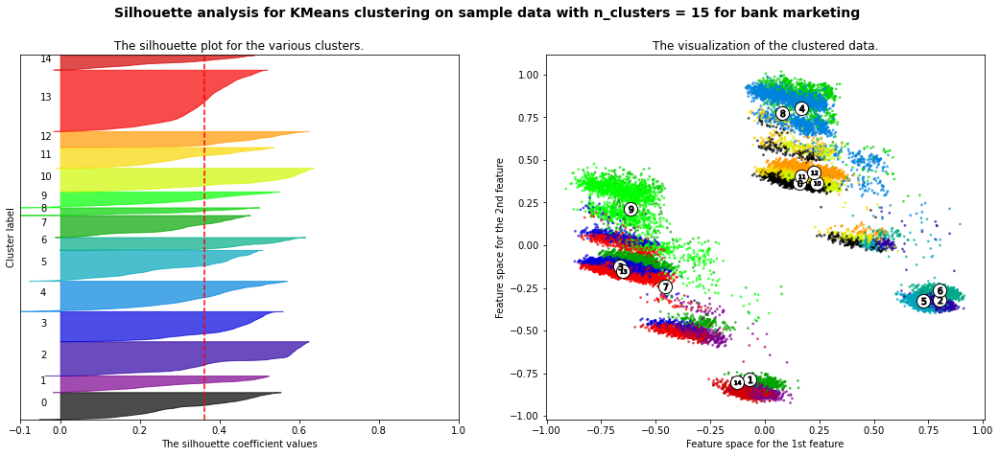

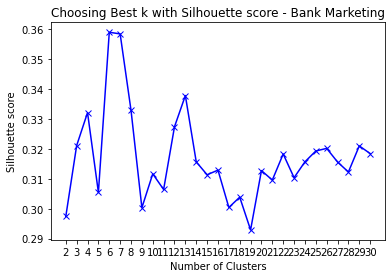

For n_clusters = 2 The average silhouette_score is : 0.2973927272705561
For n_clusters = 3 The average silhouette_score is : 0.321044124670902
For n_clusters = 4 The average silhouette_score is : 0.332024498988864
For n_clusters = 5 The average silhouette_score is : 0.305409360536884
For n_clusters = 6 The average silhouette_score is : 0.35883453003405846
For n_clusters = 7 The average silhouette_score is : 0.3582812659254073
For n_clusters = 8 The average silhouette_score is : 0.33281951698515455
For n_clusters = 9 The average silhouette_score is : 0.3003153636910144
For n_clusters = 10 The average silhouette_score is : 0.31160385148049446
For n_clusters = 11 The average silhouette_score is : 0.3063935085345298
For n_clusters = 12 The average silhouette_score is : 0.32731139170500767
For n_clusters = 13 The average silhouette_score is : 0.33771824377884646
For n_clusters = 14 The average silhouette_score is : 0.3156142312862276
For n_clusters = 15 The average silhouette_score is : 0.3

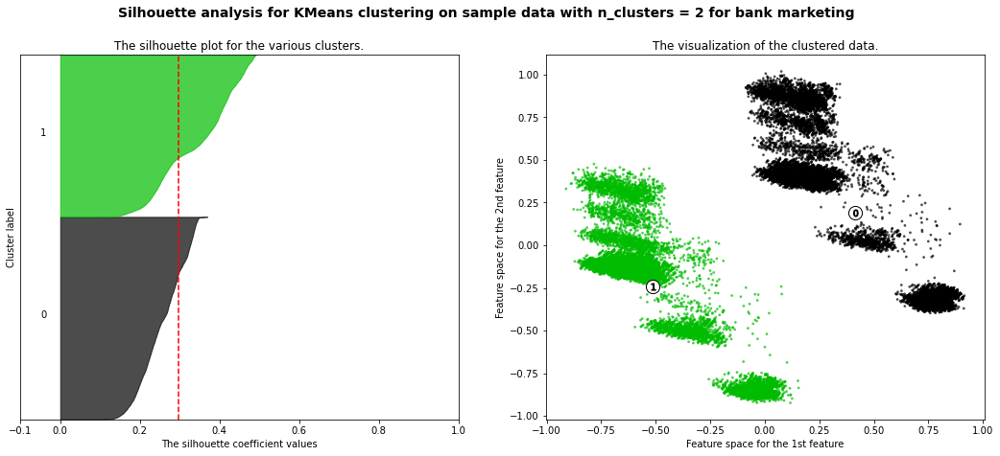

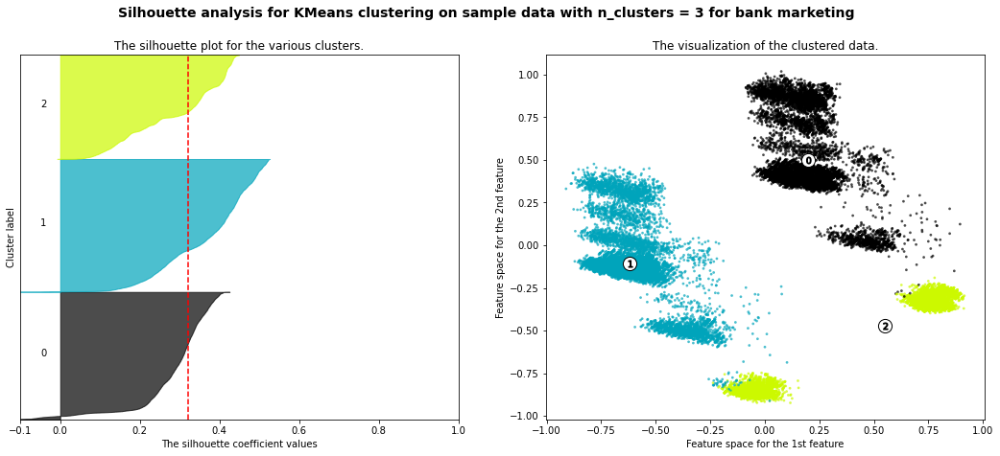

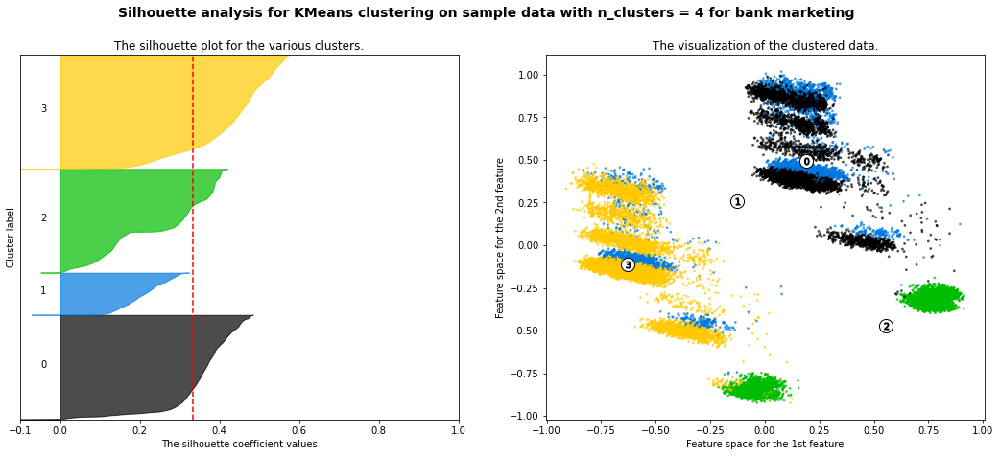

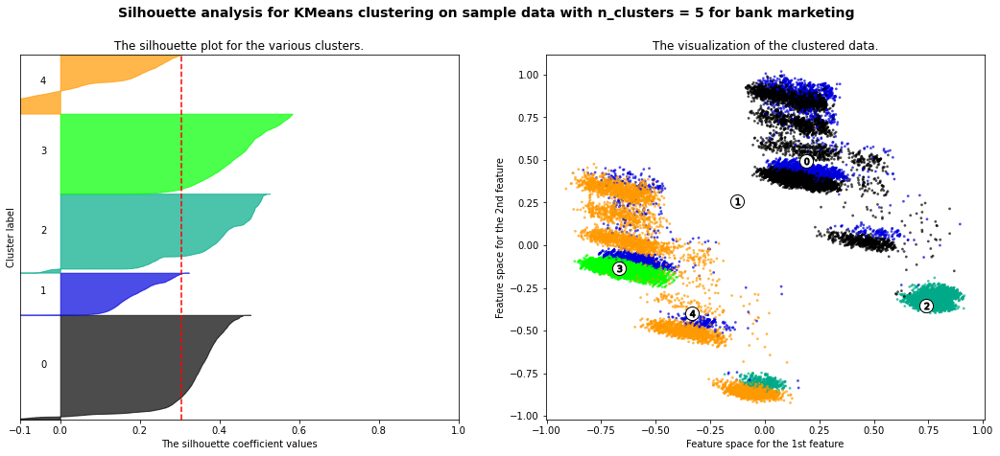

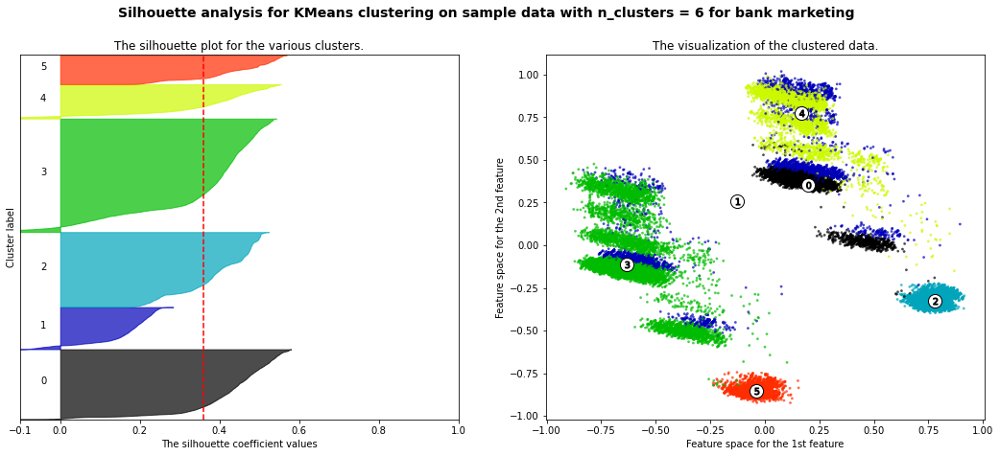

...

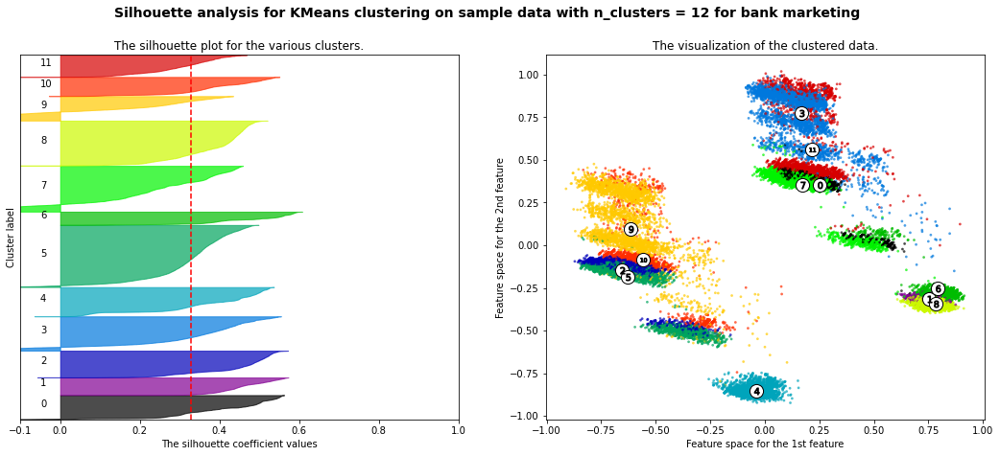

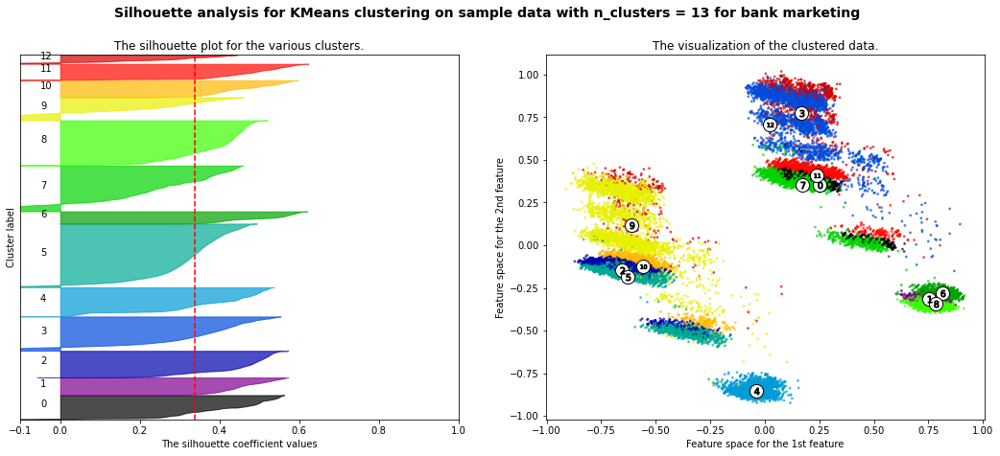

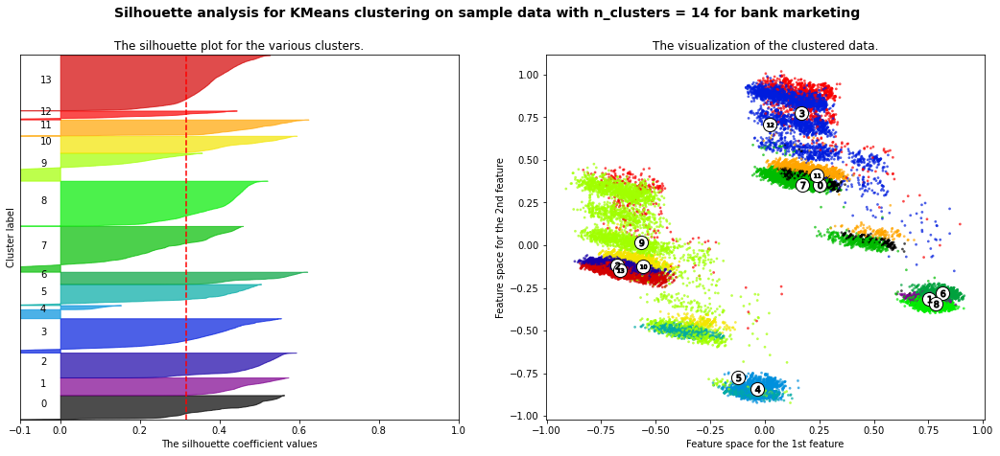

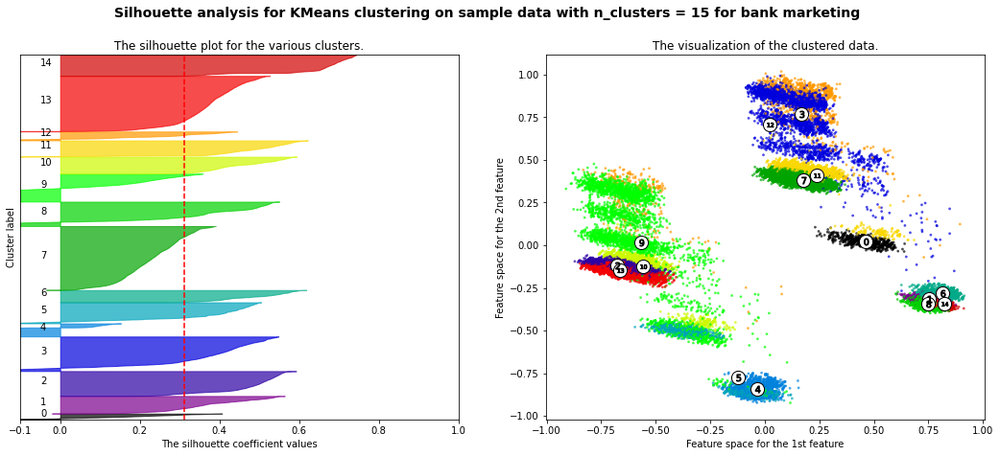

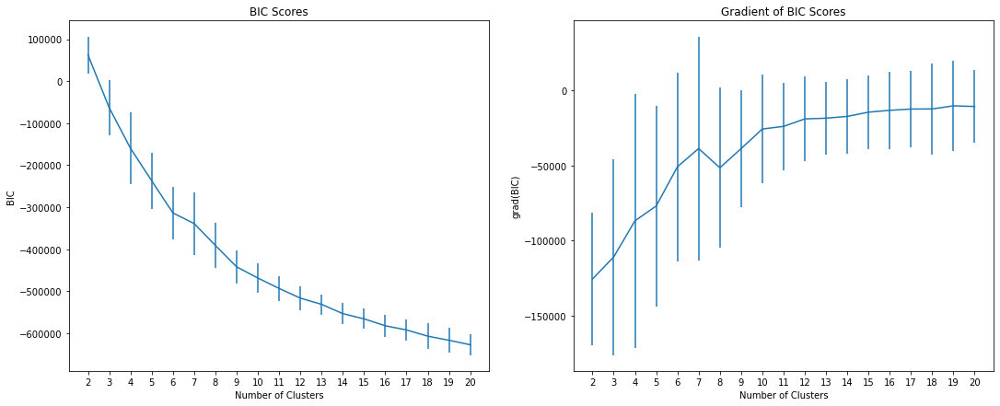

In [18]:
## redo clustering after PCA
distortion(pca_result, 31, KMeans)
silhoutte(pca_result, 21, KMeans)
silhoutte_plot(pca_result, 16, KMeans)
silhoutte(pca_result, 31, GaussianMixture)
silhoutte_plot(pca_result, 16, GaussianMixture)
EM_BIC(pca_result, 21)

0.674775527259283
0.5962122990002342


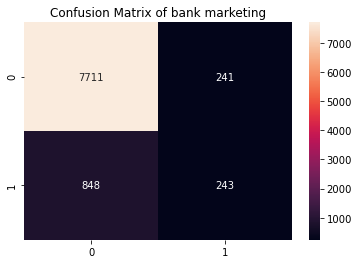

 TestAccuracy
0.8795753621585757


In [19]:
## choose 10 cluster using KMEAN for PCA, add as another feature and rerun neural net
clf=KMeans(10, random_state=42).fit(pca_result) 
cluster_labels=clf.predict(pca_result)
cluster_labels = np.reshape(cluster_labels, (-1, 1))

scaler = MinMaxScaler()
cluster_labels = scaler.fit_transform(cluster_labels)

pca_result =np.hstack((pca_result, cluster_labels))


train_features_PCA, test_features_PCA, train_labels, test_labels = train_test_split(pca_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)

## rerun NN after PCA and clusteriong

MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_PCA, train_labels)

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_PCA)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_PCA)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

###### ICA

In [20]:
### choose best number of components of ICA through random forest classfier
for i in range(2,11):
    ica = FastICA(n_components=i, max_iter=10000, tol=0.1,random_state=12) 
    ica_result = ica.fit_transform(features)
    train_features_ICA, test_features_ICA, train_labels, test_labels = train_test_split(ica_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)
    
    clf = RandomForestClassifier(criterion='entropy', max_depth=5,min_samples_split=2, min_samples_leaf = 8, random_state = 42)

    clf.fit(train_features_ICA, train_labels)
    test_pred_decision_tree = clf.predict(test_features_ICA)
    print("For n component =",
            i,metrics.accuracy_score(test_labels, test_pred_decision_tree))

For n component = 2 0.8879796527700984
For n component = 3 0.8793541966161672
For n component = 4 0.8793541966161672
For n component = 5 0.8830034280659074
For n component = 6 0.8793541966161672
For n component = 7 0.8793541966161672
For n component = 8 0.8793541966161672
For n component = 9 0.883777507464337
For n component = 10 0.8824505142098861


In [84]:
features.shape

(45211, 16)

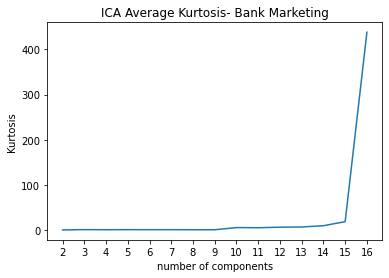

In [81]:
## kurtosis analysis
kurt = []
ncomponent = np.arange(2, 17)
for i in ncomponent:
    ica = FastICA(n_components=i, max_iter=10000, tol=0.1,random_state=12) 
    ica_result = ica.fit_transform(features)
    kurt_i = pd.DataFrame(ica_result)
    kurt_i = kurt_i.kurt(axis=0)
    kurt_i = kurt_i.abs().mean()
    kurt.append(kurt_i)

plt.plot(ncomponent, kurt)
plt.xlabel('number of components')
plt.xticks(ncomponent)
plt.ylabel('Kurtosis')
plt.title("ICA Average Kurtosis- Bank Marketing")
plt.show()

In [82]:
kurt

[0.7725768263909574,
 1.4296634946246385,
 1.2077596962947097,
 1.3567054246857553,
 1.2793279869885423,
 1.3198716700857605,
 1.1550965880485338,
 1.1095133833406963,
 5.94273200982805,
 5.587177752152303,
 6.793341153168684,
 7.237897673045818,
 10.056907131649167,
 19.047625111351838,
 437.7268735014001]

In [85]:
## n component chose to be 16
ica = FastICA(n_components=16, max_iter=10000, tol=0.1,random_state=12) 
ica_result = ica.fit_transform(features)
print('ICA Transformed Features Shape:', ica_result.shape)
train_features_ICA, test_features_ICA, train_labels, test_labels = train_test_split(ica_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)
print('ICA Transformed Training Features Shape:', train_features_ICA.shape)
print('Training Labels Shape:', train_labels.shape)
print('ICA Transformed Testing Features Shape:', test_features_ICA.shape)
print('Testing Labels Shape:', test_labels.shape)

ICA Transformed Features Shape: (45211, 16)
ICA Transformed Training Features Shape: (36168, 16)
Training Labels Shape: (36168,)
ICA Transformed Testing Features Shape: (9043, 16)
Testing Labels Shape: (9043,)


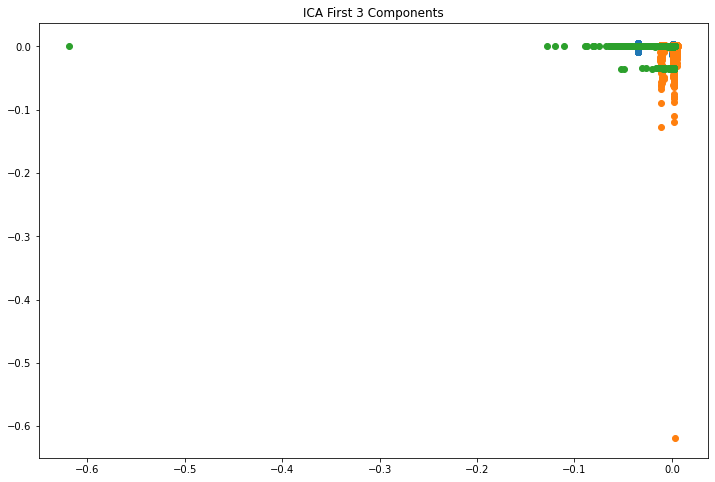

In [87]:
plt.figure(figsize=(12,8))
plt.title('ICA First 3 Components')
plt.scatter(ica_result[:,0], ica_result[:,1])
plt.scatter(ica_result[:,1], ica_result[:,2])
plt.scatter(ica_result[:,2], ica_result[:,0])

0.7278600128783193
0.6542089959555684


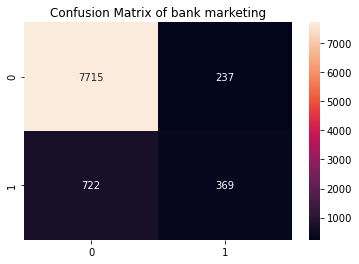

 TestAccuracy
0.8939511224151278


In [88]:
MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_ICA, train_labels)
                       

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_ICA)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_ICA)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

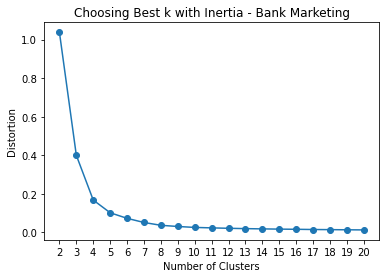

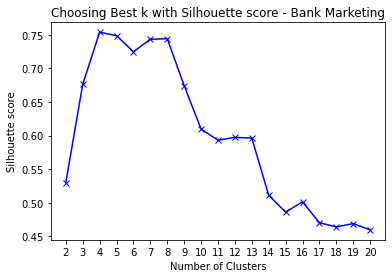

For n_clusters = 2 The average silhouette_score is : 0.5297242872595406
For n_clusters = 3 The average silhouette_score is : 0.6762451468325715
For n_clusters = 4 The average silhouette_score is : 0.7539766206752878
For n_clusters = 5 The average silhouette_score is : 0.748903299683938
For n_clusters = 6 The average silhouette_score is : 0.7249448284304582
For n_clusters = 7 The average silhouette_score is : 0.7434873087201366
For n_clusters = 8 The average silhouette_score is : 0.7444109586470758
For n_clusters = 9 The average silhouette_score is : 0.6744575924374918
For n_clusters = 10 The average silhouette_score is : 0.6097537089988897
For n_clusters = 11 The average silhouette_score is : 0.5931165866974397
For n_clusters = 12 The average silhouette_score is : 0.5973125097078217
For n_clusters = 13 The average silhouette_score is : 0.5962937056027424
For n_clusters = 14 The average silhouette_score is : 0.5109763776812004
For n_clusters = 15 The average silhouette_score is : 0.4859

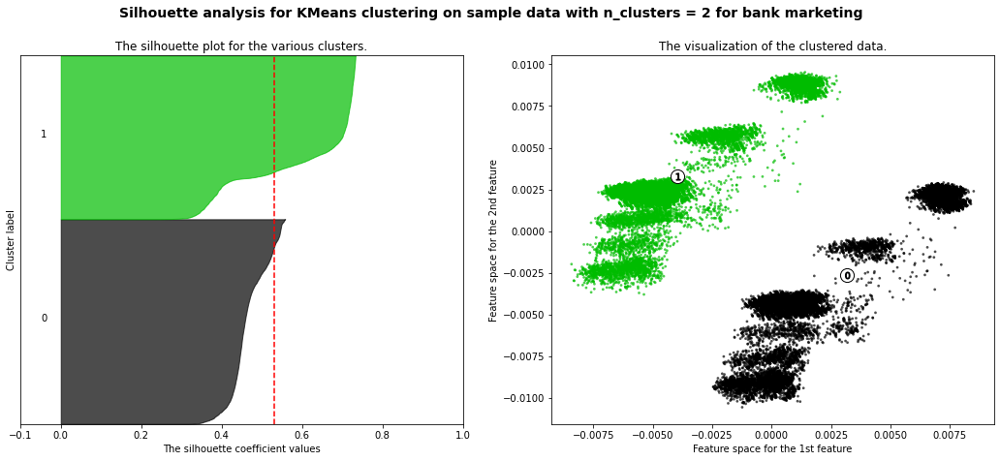

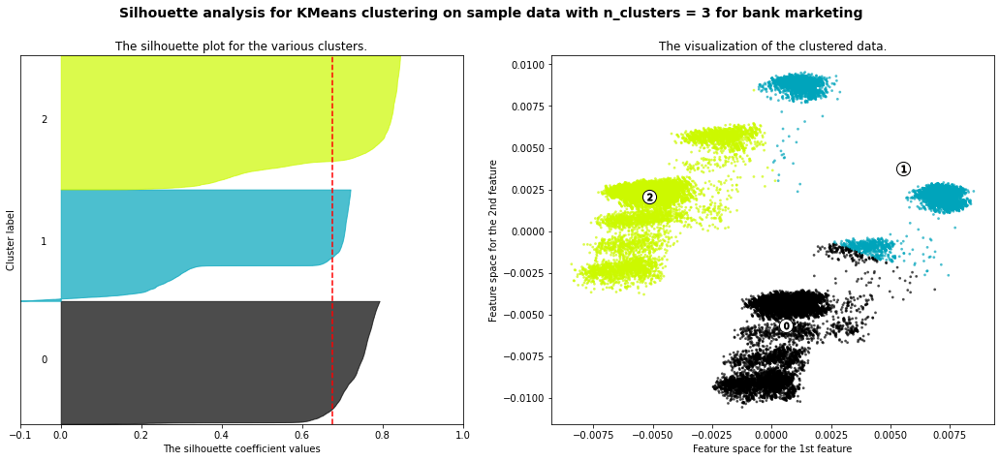

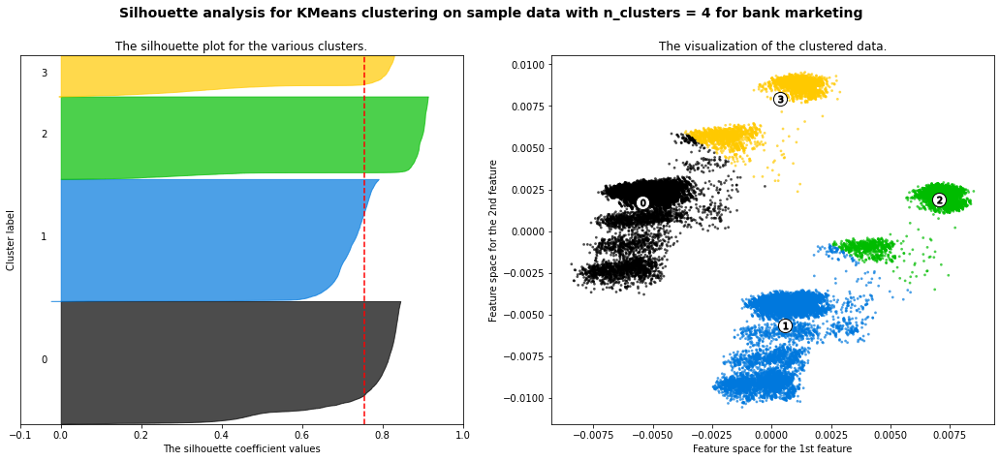

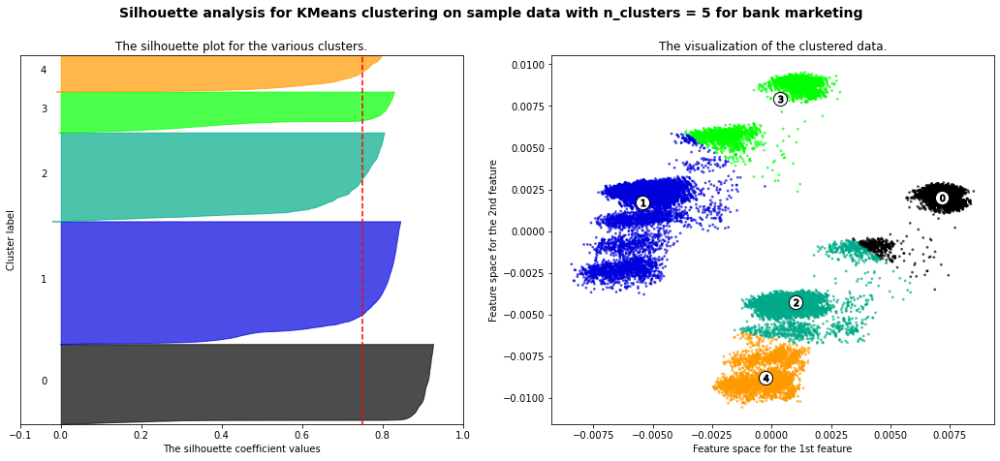

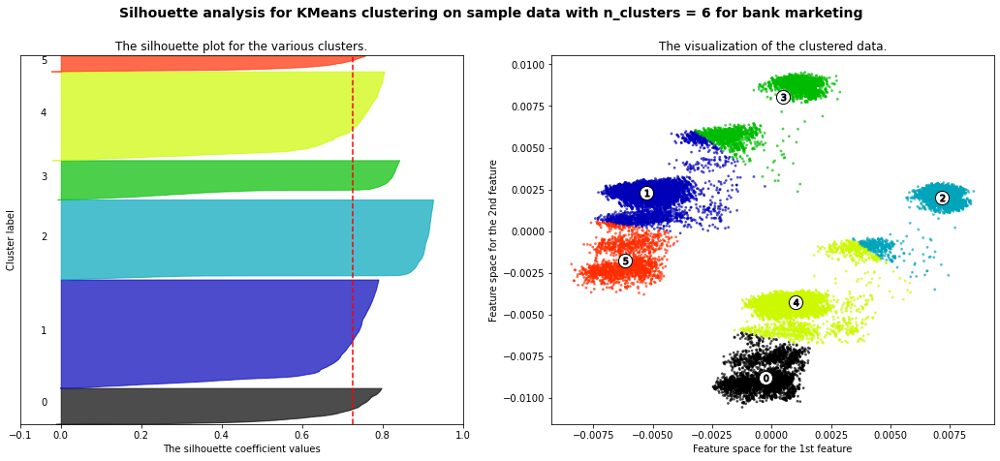

...

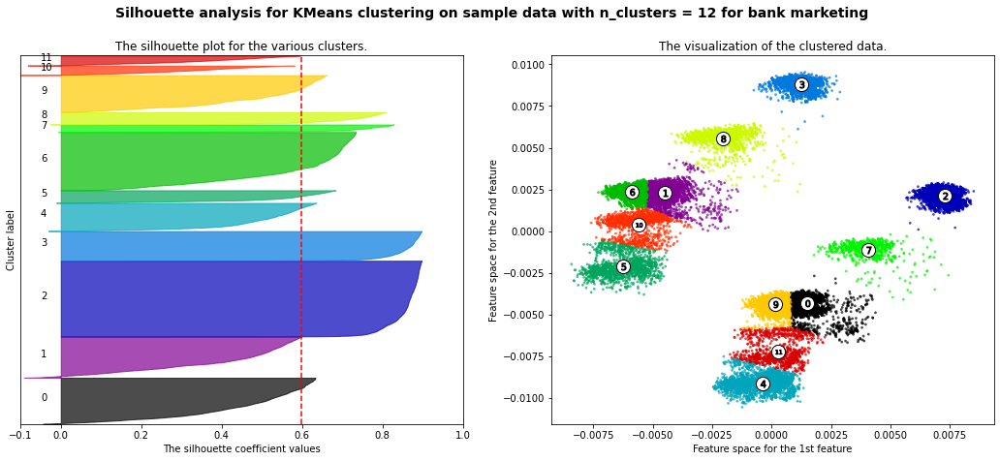

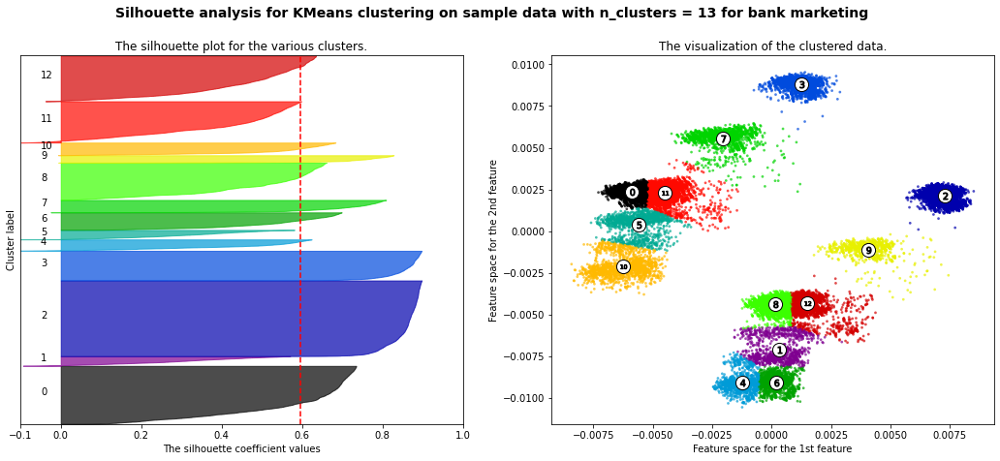

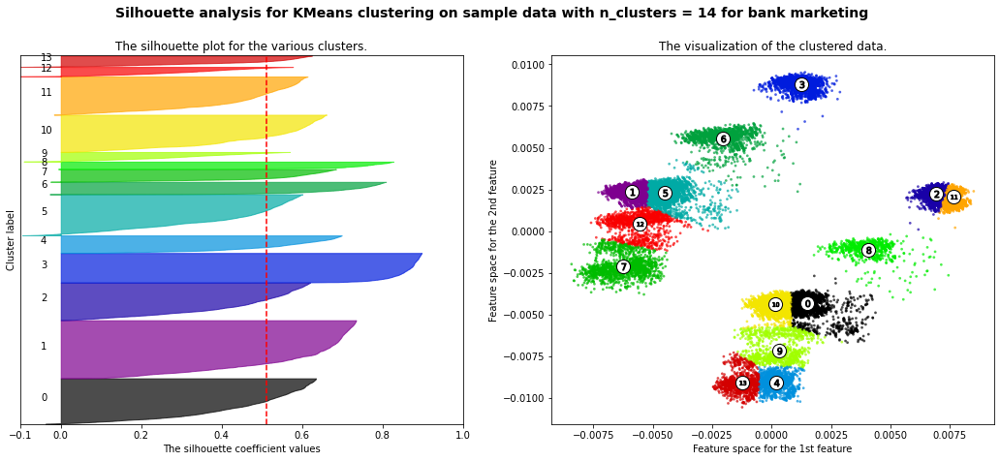

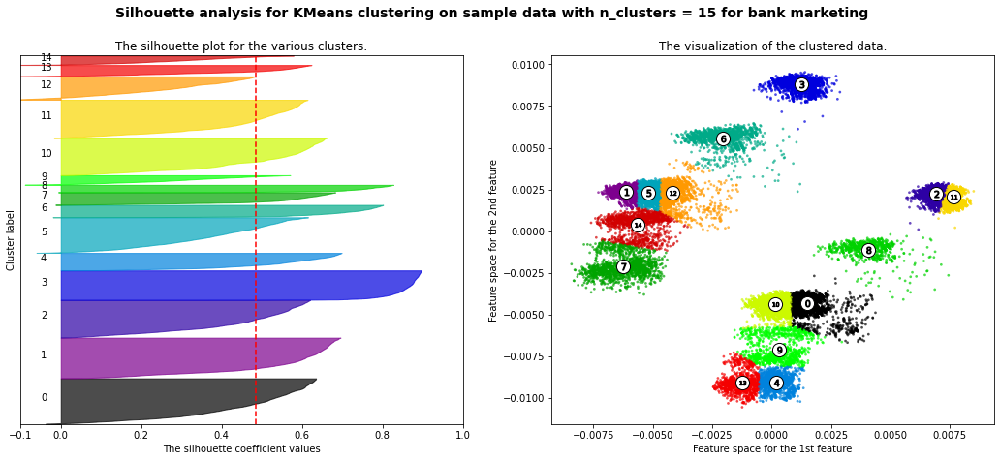

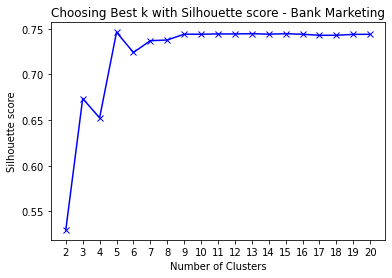

For n_clusters = 2 The average silhouette_score is : 0.5297242872595406
For n_clusters = 3 The average silhouette_score is : 0.6736111621570142
For n_clusters = 4 The average silhouette_score is : 0.6524012504179623
For n_clusters = 5 The average silhouette_score is : 0.746154886228502
For n_clusters = 6 The average silhouette_score is : 0.7240027576773402
For n_clusters = 7 The average silhouette_score is : 0.736906135394076
For n_clusters = 8 The average silhouette_score is : 0.737658502539895
For n_clusters = 9 The average silhouette_score is : 0.7440322783530161
For n_clusters = 10 The average silhouette_score is : 0.7439864892007289
For n_clusters = 11 The average silhouette_score is : 0.744296609243428
For n_clusters = 12 The average silhouette_score is : 0.744296609243428
For n_clusters = 13 The average silhouette_score is : 0.7445655562079628
For n_clusters = 14 The average silhouette_score is : 0.744065081208877
For n_clusters = 15 The average silhouette_score is : 0.744514782

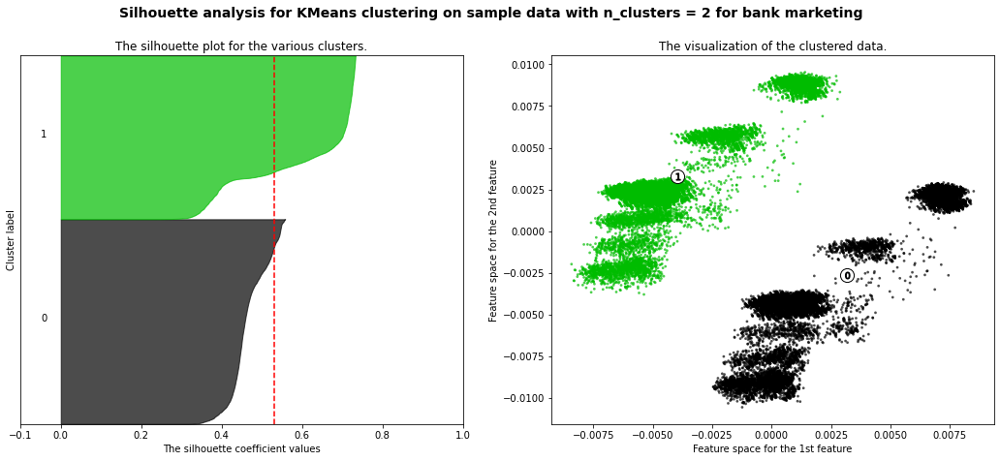

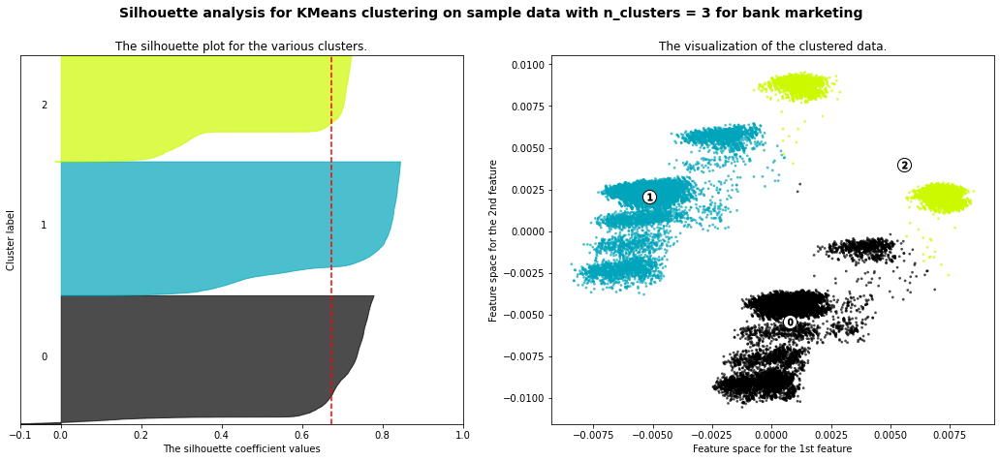

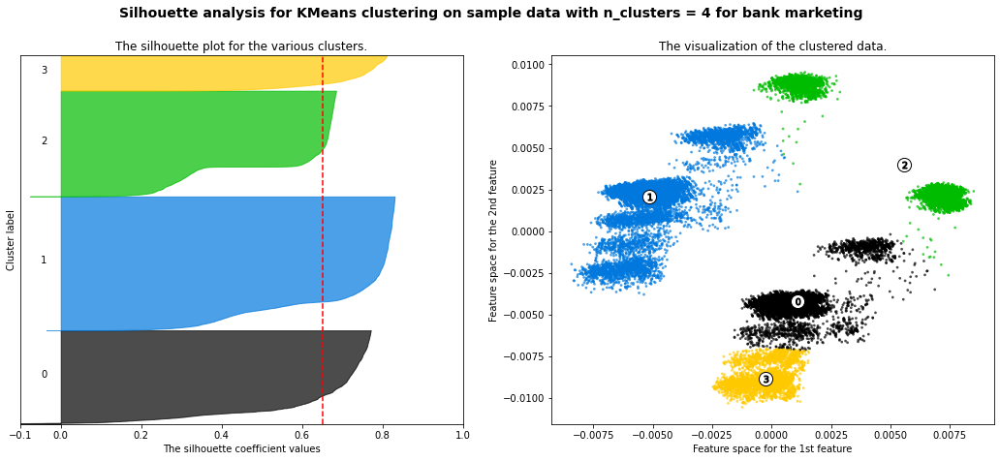

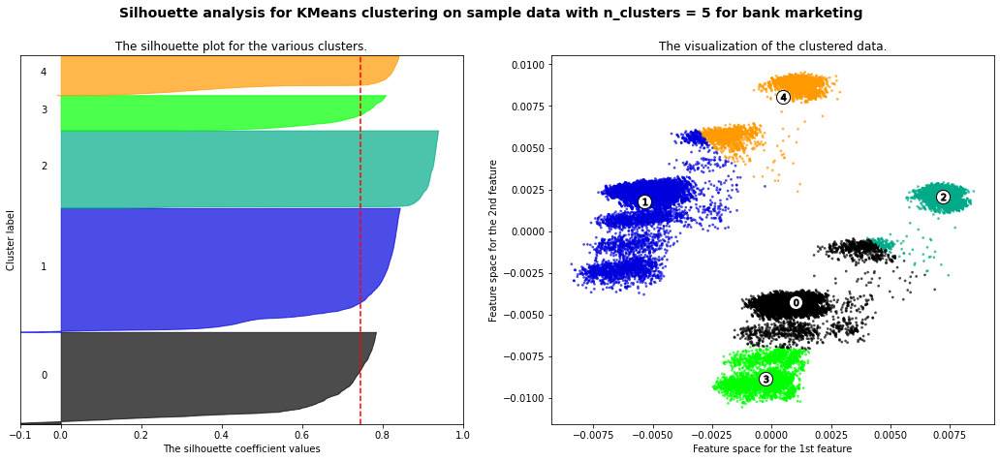

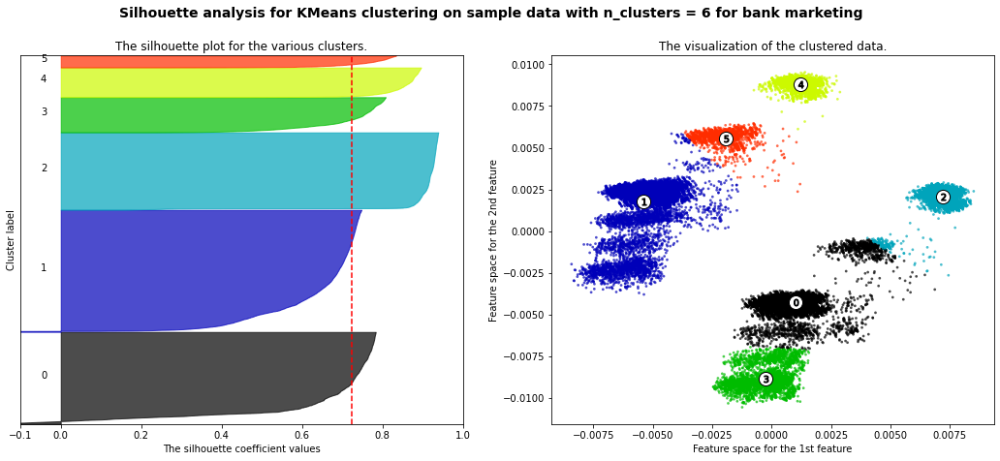

...

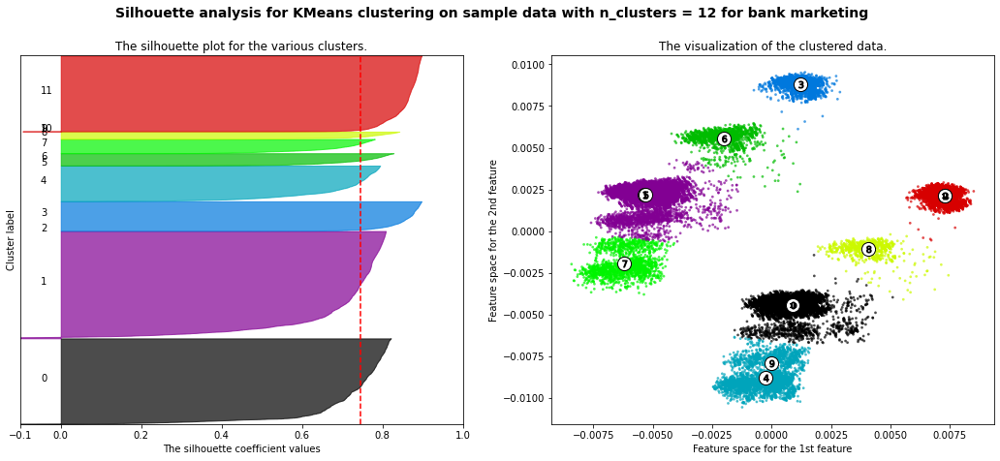

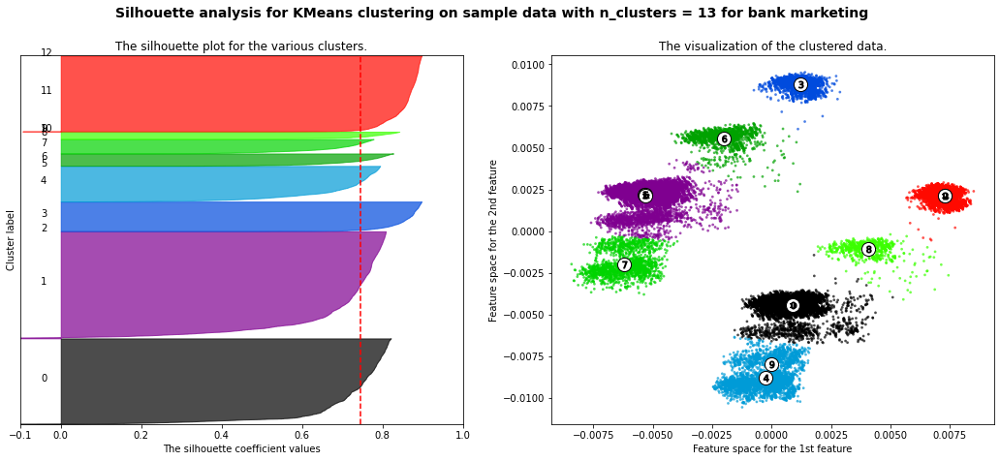

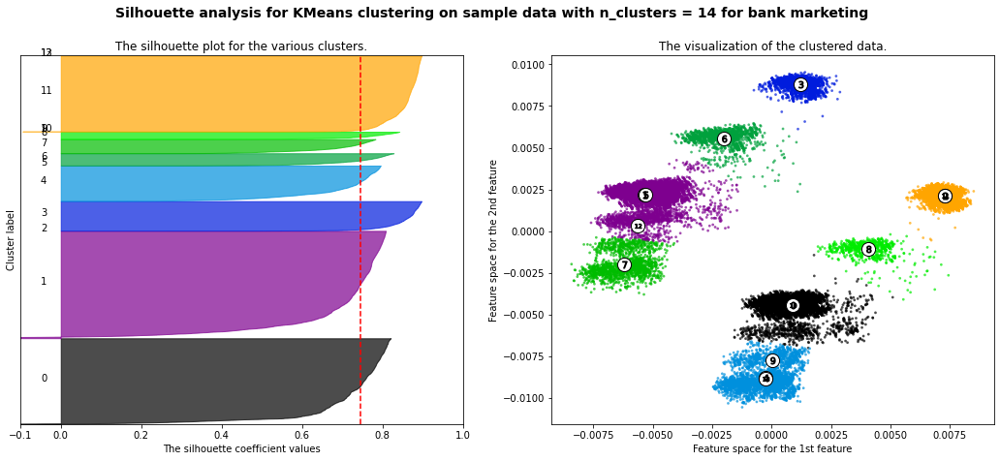

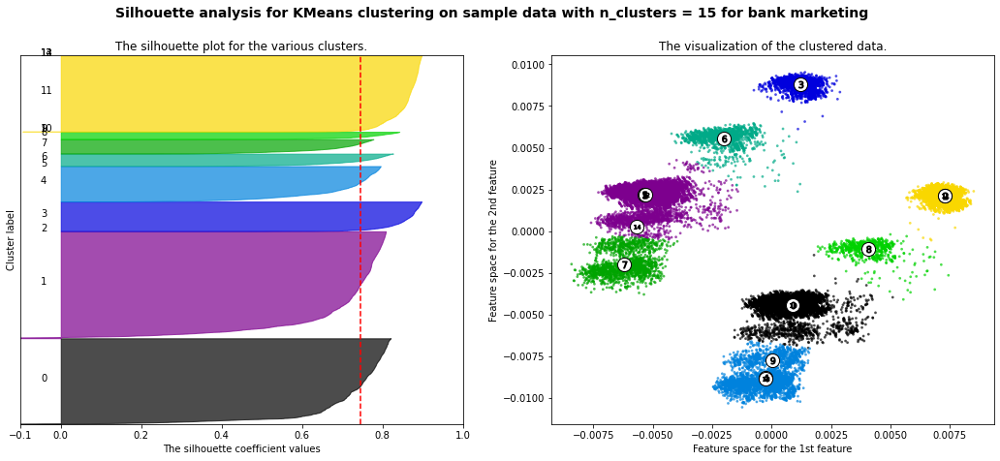

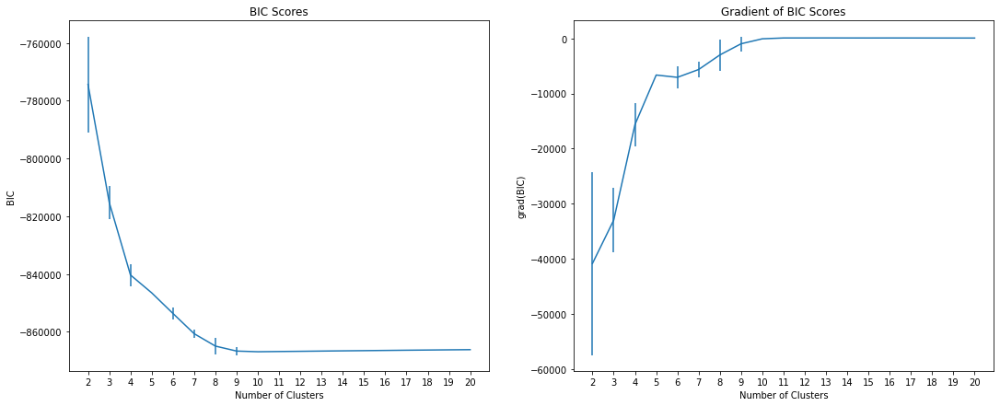

In [24]:
## redo clustering after ICA
distortion(ica_result, 21, KMeans)
silhoutte(ica_result, 21, KMeans)
silhoutte_plot(ica_result, 16, KMeans)
silhoutte(ica_result, 21, GaussianMixture)
silhoutte_plot(ica_result, 16, GaussianMixture)
EM_BIC(ica_result, 21)

0.5574252332500261
0.5574237127623671


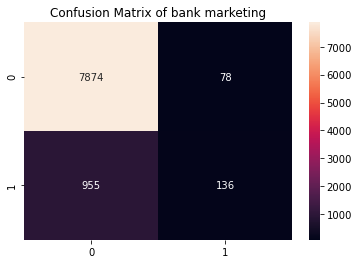

 TestAccuracy
0.8857679973460135


In [25]:
## choose 4 cluster using KMEAN for ICA, add as another feature and rerun neural net
clf=KMeans(4, random_state=42).fit(ica_result) 
cluster_labels=clf.predict(ica_result)
cluster_labels = np.reshape(cluster_labels, (-1, 1))

scaler = MinMaxScaler()
cluster_labels = scaler.fit_transform(cluster_labels)

ica_result =np.hstack((ica_result, cluster_labels))


train_features_ICA, test_features_ICA, train_labels, test_labels = train_test_split(ica_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)

## rerun NN after ICA and clusteriong

MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_ICA, train_labels)

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_ICA)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_ICA)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

###### Randomized projection

In [50]:
### choose best number of components of randomized projection through random forest classfier
for i in range(2,10):
    rp = GaussianRandomProjection(n_components=i, eps=0.1,random_state=12) 
    rp_result = rp.fit_transform(features)
    train_features_RP, test_features_RP, train_labels, test_labels = train_test_split(rp_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)
    
    clf = RandomForestClassifier(criterion='entropy', max_depth=5,min_samples_split=2, min_samples_leaf = 8, random_state = 42)

    clf.fit(train_features_RP, train_labels)
    test_pred_decision_tree = clf.predict(test_features_RP)
    print("For n component =",
            i,metrics.accuracy_score(test_labels, test_pred_decision_tree))

For n component = 2 0.8793541966161672
For n component = 3 0.8793541966161672
For n component = 4 0.8793541966161672
For n component = 5 0.8793541966161672
For n component = 6 0.8793541966161672
For n component = 7 0.8793541966161672
For n component = 8 0.8793541966161672
For n component = 9 0.8793541966161672


In [55]:
johnson_lindenstrauss_min_dim(n_samples = 45211, eps=0.1)

9187

In [27]:
## n component chose to be 2
rp = GaussianRandomProjection(n_components=2, eps=0.1,random_state=12)  
rp_result = rp.fit_transform(features)
print('RP Transformed Features Shape:', rp_result.shape)
train_features_RP, test_features_RP, train_labels, test_labels = train_test_split(rp_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)
print('RP Transformed Training Features Shape:', train_features_RP.shape)
print('Training Labels Shape:', train_labels.shape)
print('RP Transformed Testing Features Shape:', test_features_RP.shape)
print('Testing Labels Shape:', test_labels.shape)

RP Transformed Features Shape: (45211, 2)
RP Transformed Training Features Shape: (36168, 2)
Training Labels Shape: (36168,)
RP Transformed Testing Features Shape: (9043, 2)
Testing Labels Shape: (9043,)


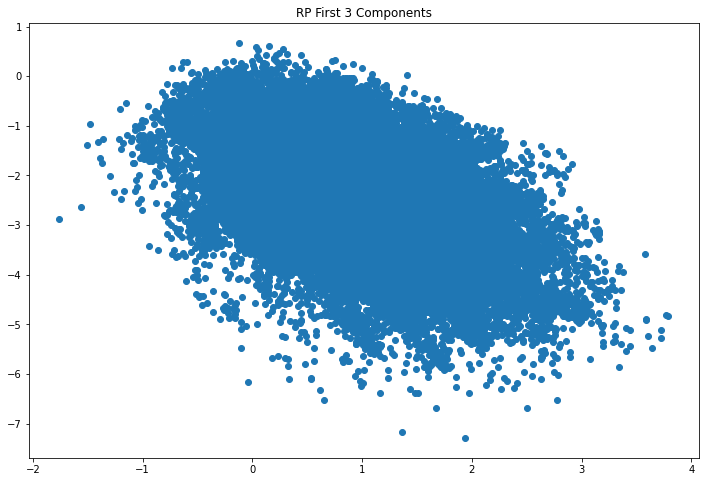

In [28]:
plt.figure(figsize=(12,8))
plt.title('RP First 3 Components')
plt.scatter(rp_result[:,0], rp_result[:,1])
# plt.scatter(rp_result[:,1], rp_result[:,2])
# plt.scatter(rp_result[:,2], rp_result[:,0])

0.5006520673636536
0.5004582951420715


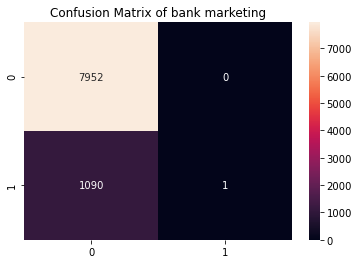

 TestAccuracy
0.8794647793873714


In [29]:
## rerun NN after RP and clusteriong

MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_RP, train_labels)

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_RP)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_RP)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

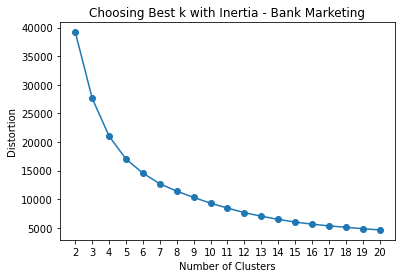

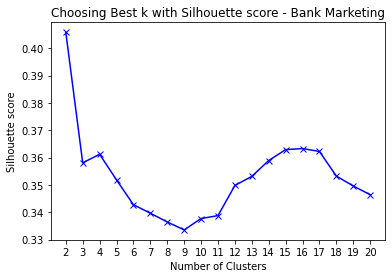

For n_clusters = 2 The average silhouette_score is : 0.4058602923039071
For n_clusters = 3 The average silhouette_score is : 0.3580912236767151
For n_clusters = 4 The average silhouette_score is : 0.36122415465130625
For n_clusters = 5 The average silhouette_score is : 0.35183442462604636
For n_clusters = 6 The average silhouette_score is : 0.34278542956926245
For n_clusters = 7 The average silhouette_score is : 0.33965790159716996
For n_clusters = 8 The average silhouette_score is : 0.33646360861564334
For n_clusters = 9 The average silhouette_score is : 0.3335540031964961
For n_clusters = 10 The average silhouette_score is : 0.33771604905427965
For n_clusters = 11 The average silhouette_score is : 0.33877881993491227
For n_clusters = 12 The average silhouette_score is : 0.34981184081349226
For n_clusters = 13 The average silhouette_score is : 0.3531394578776478
For n_clusters = 14 The average silhouette_score is : 0.3589267986526209
For n_clusters = 15 The average silhouette_score is

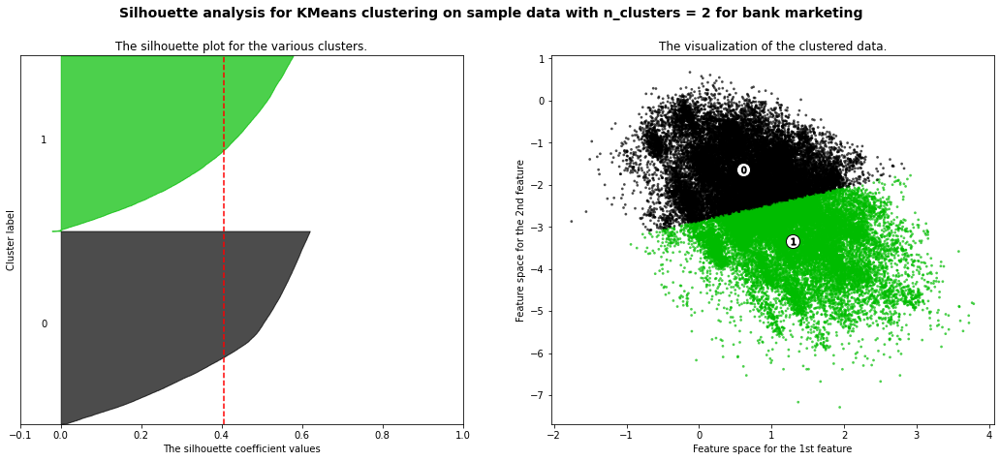

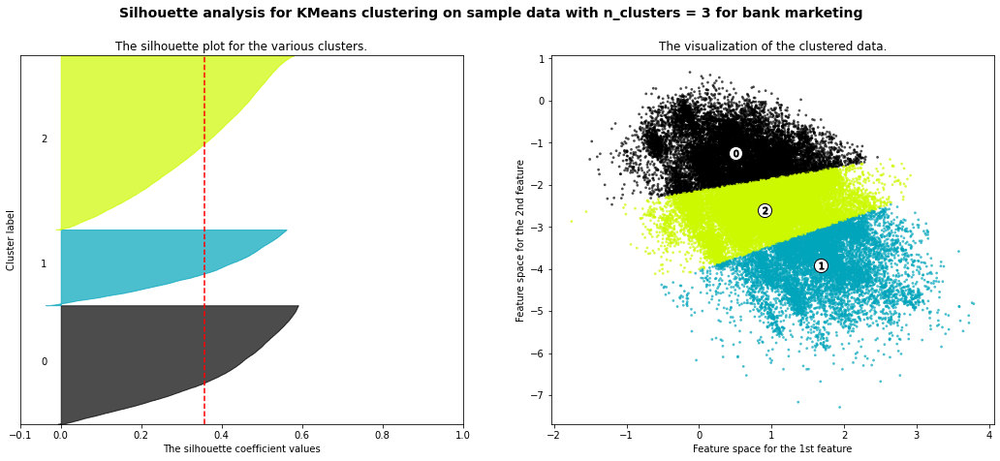

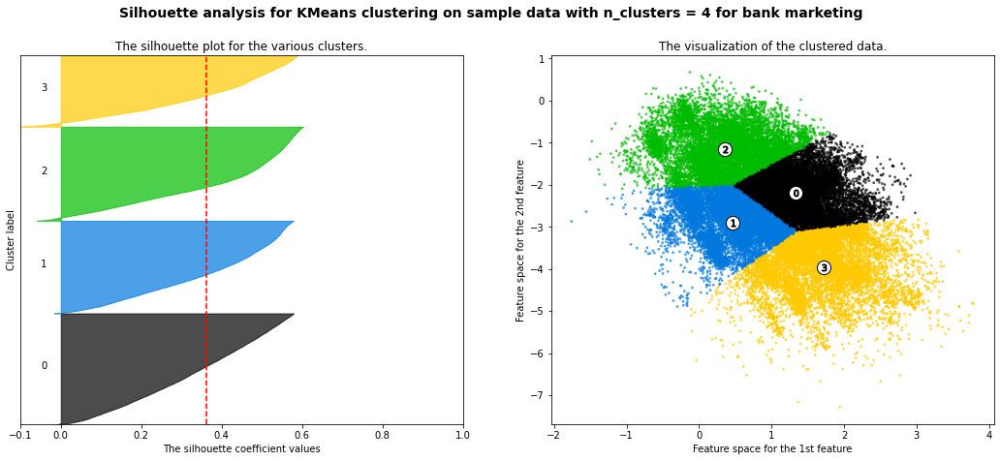

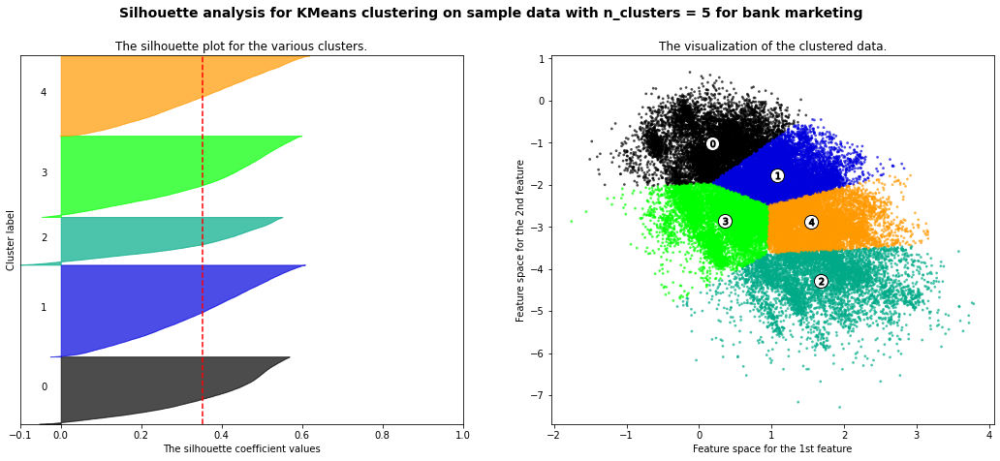

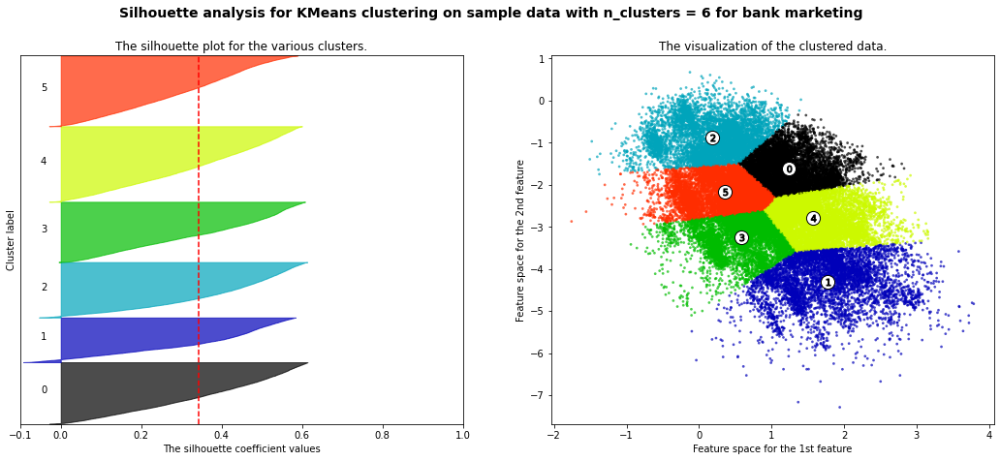

...

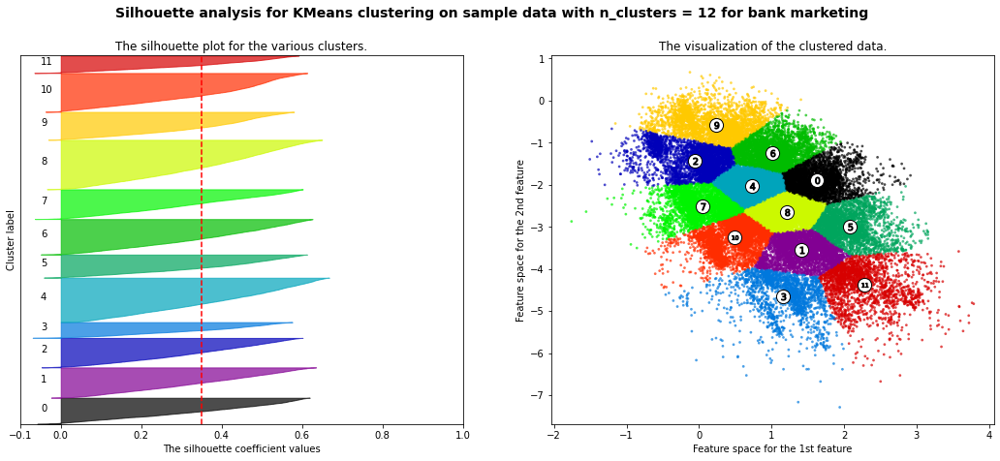

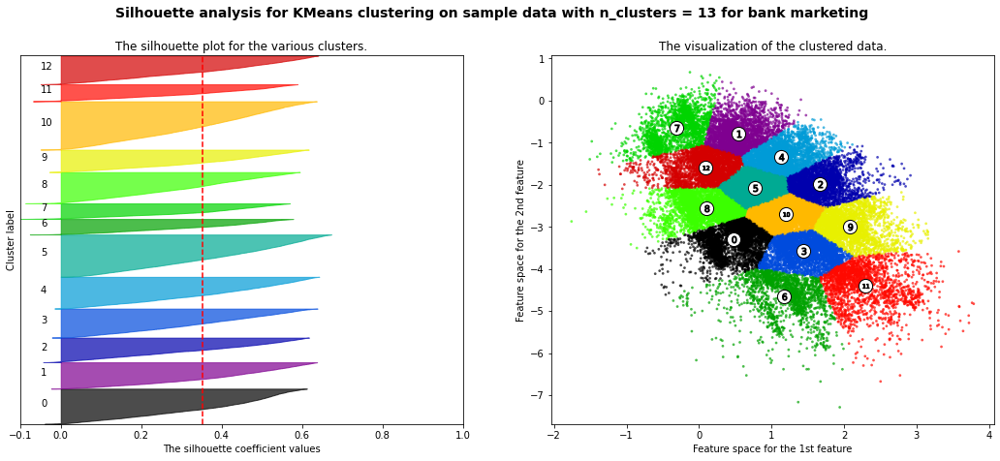

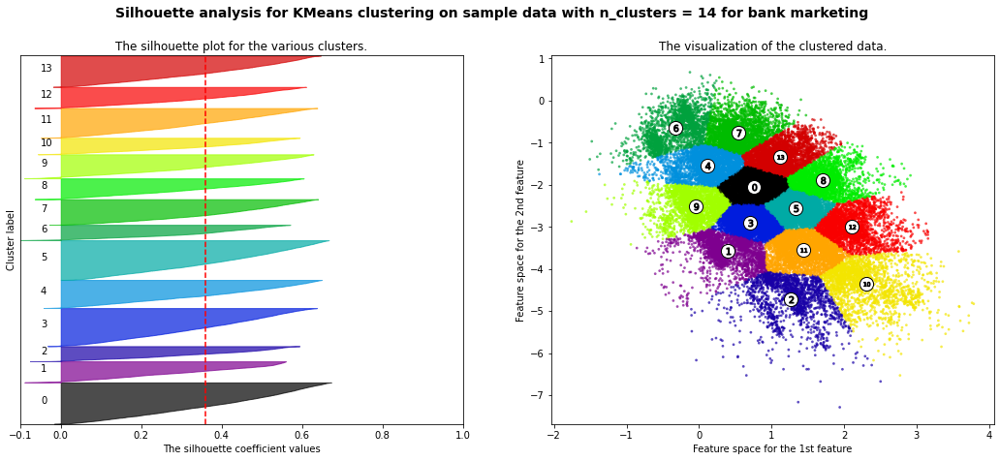

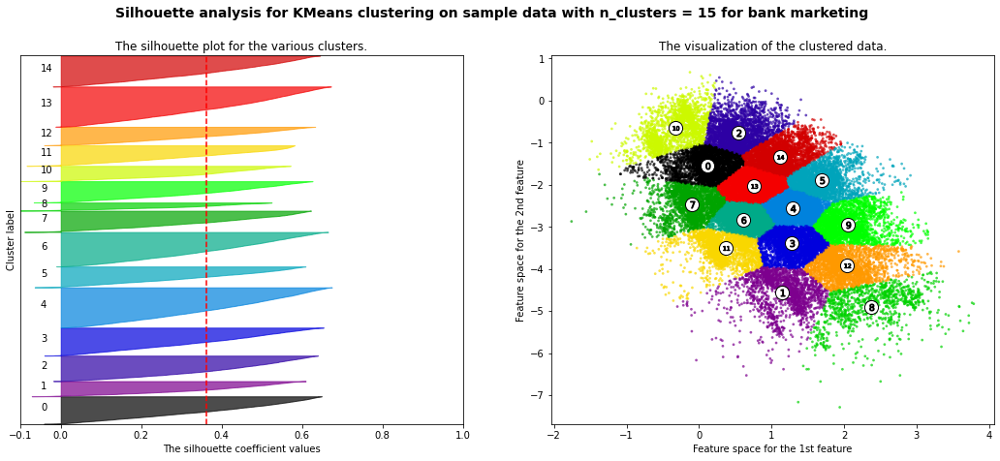

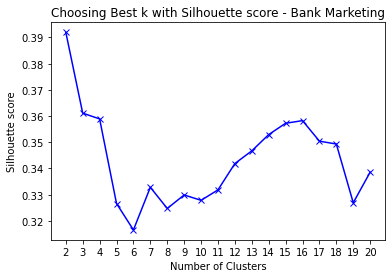

For n_clusters = 2 The average silhouette_score is : 0.39198878598270565
For n_clusters = 3 The average silhouette_score is : 0.3611196987865586
For n_clusters = 4 The average silhouette_score is : 0.3589130978775222
For n_clusters = 5 The average silhouette_score is : 0.32663412348736726
For n_clusters = 6 The average silhouette_score is : 0.31655688580497954
For n_clusters = 7 The average silhouette_score is : 0.33282784027686313
For n_clusters = 8 The average silhouette_score is : 0.32473487622327224
For n_clusters = 9 The average silhouette_score is : 0.3299010416149802
For n_clusters = 10 The average silhouette_score is : 0.32785275945671327
For n_clusters = 11 The average silhouette_score is : 0.3318326214380892
For n_clusters = 12 The average silhouette_score is : 0.3418888514578724
For n_clusters = 13 The average silhouette_score is : 0.34672251452399516
For n_clusters = 14 The average silhouette_score is : 0.3529361465194215
For n_clusters = 15 The average silhouette_score is 

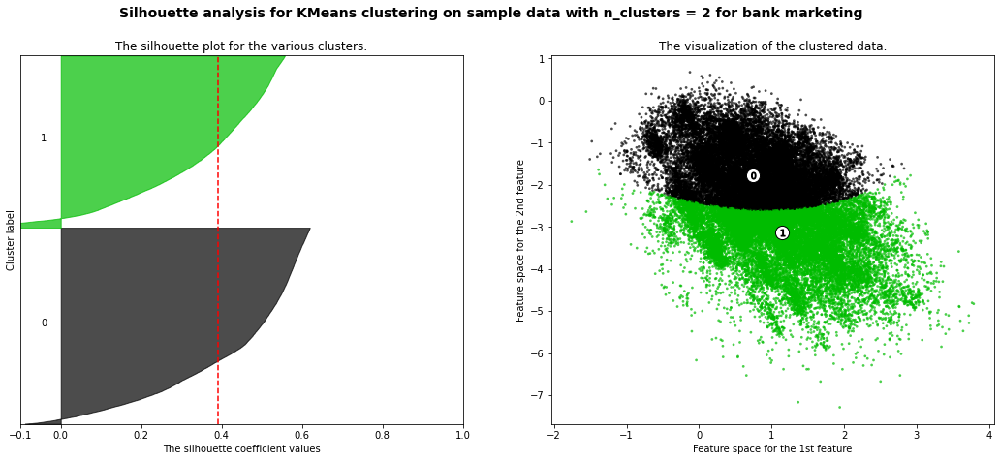

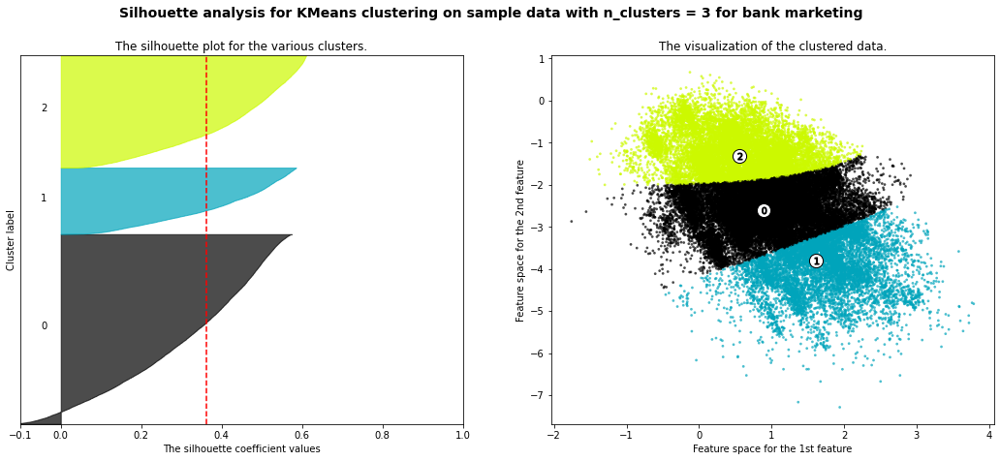

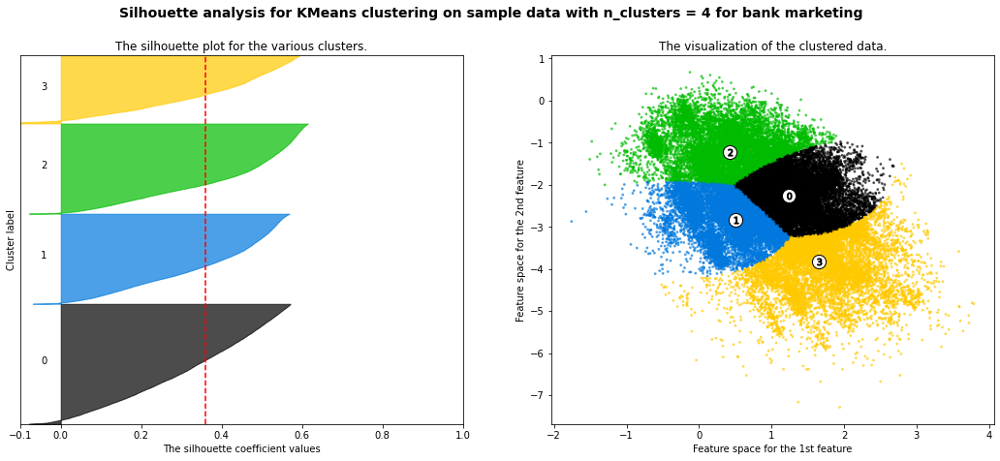

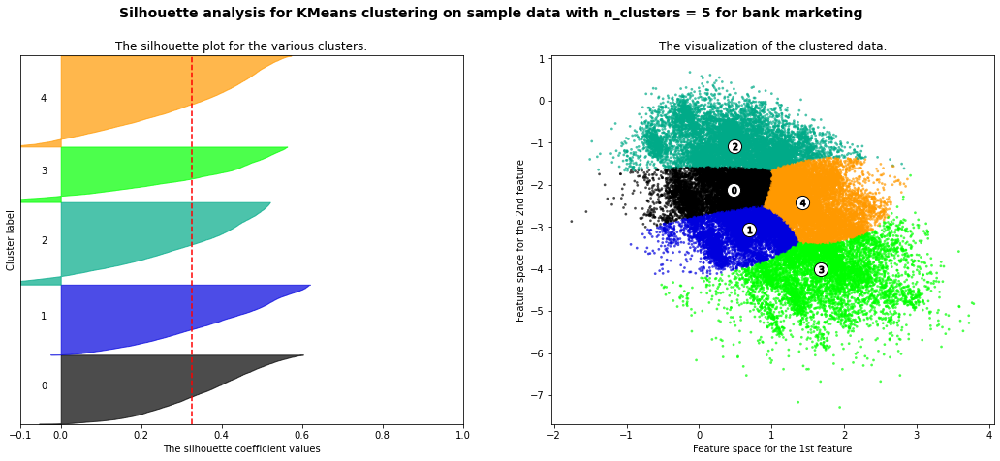

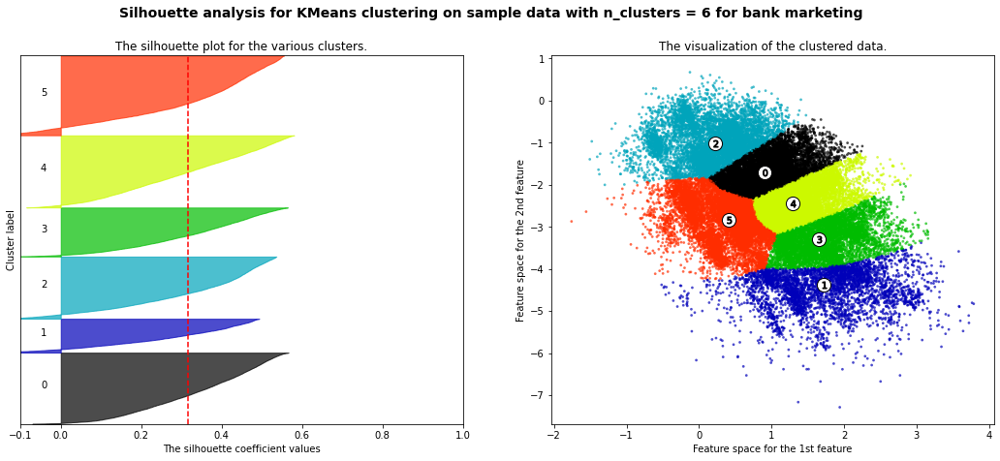

...

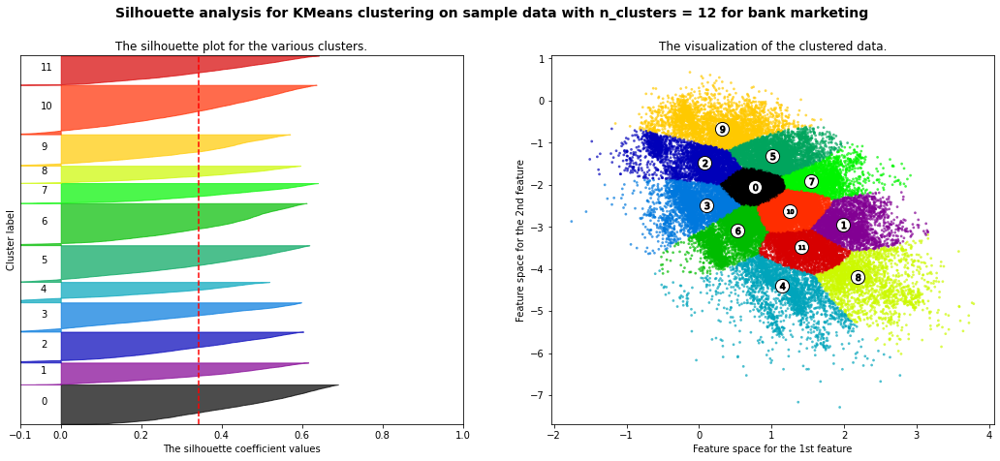

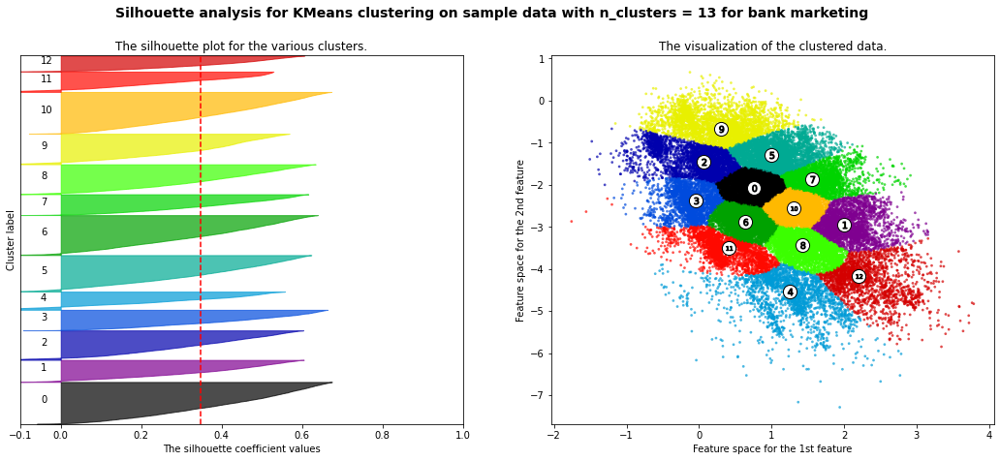

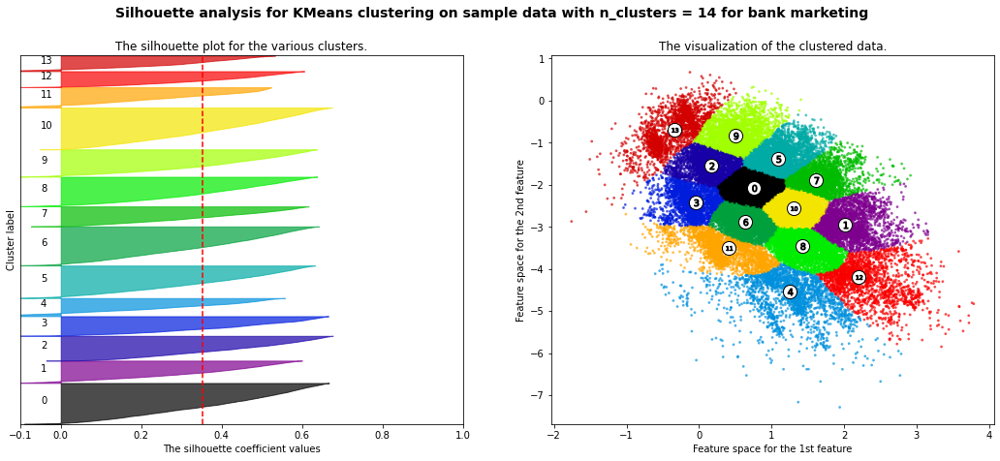

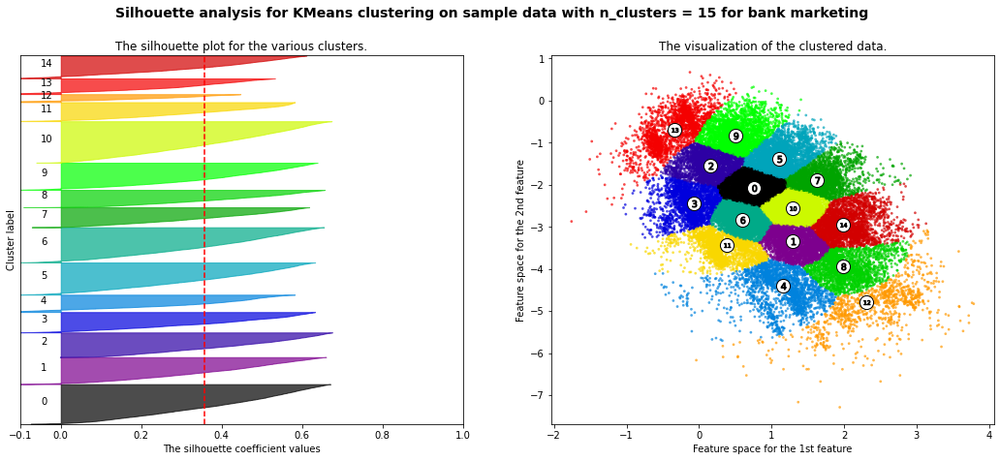

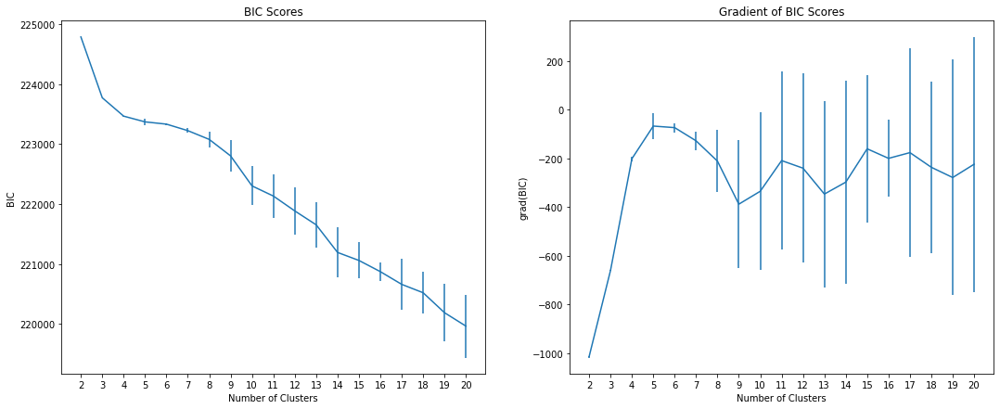

In [30]:
## redo clustering after RP
distortion(rp_result, 21, KMeans)
silhoutte(rp_result, 21, KMeans)
silhoutte_plot(rp_result, 16, KMeans)
silhoutte(rp_result, 21, GaussianMixture)
silhoutte_plot(rp_result, 16, GaussianMixture)
EM_BIC(rp_result, 21)

0.5017649124067153
0.5013120081626329


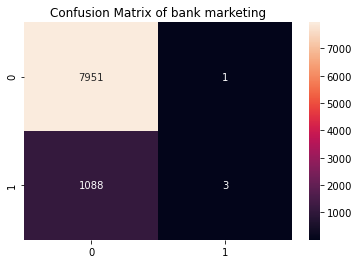

 TestAccuracy
0.8795753621585757


In [31]:
## choose 2 cluster using KMEAN for RP, add as another feature and rerun neural net
clf=KMeans(2, random_state=42).fit(rp_result) 
cluster_labels=clf.predict(rp_result)
cluster_labels = np.reshape(cluster_labels, (-1, 1))

scaler = MinMaxScaler()
cluster_labels = scaler.fit_transform(cluster_labels)

rp_result =np.hstack((rp_result, cluster_labels))


train_features_RP, test_features_RP, train_labels, test_labels = train_test_split(rp_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)

## rerun NN after RP and clusteriong

MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_RP, train_labels)

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_RP)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_RP)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

###### correlation filter

In [32]:
pd.DataFrame(features).corr()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,1.000000,0.097783,-0.009120,-0.004648,0.004760,-0.023758,0.001288,-0.021868,-0.403240,-0.106807,-0.017879,-0.185513,-0.015655,0.026221,-0.042357,0.007367
1,0.097783,1.000000,0.004503,0.021560,-0.014578,0.003435,0.016674,0.018232,0.002122,0.064514,-0.066745,-0.068768,-0.084350,-0.027273,0.019777,-0.020967
2,-0.009120,0.004503,1.000000,-0.030206,0.162490,-0.093044,-0.051710,0.022856,-0.005261,0.022671,0.009424,-0.027982,0.011370,-0.027936,-0.006028,0.083460
3,-0.004648,0.021560,-0.030206,1.000000,-0.084570,-0.001565,0.001203,0.004744,0.011852,0.001935,-0.010021,0.005075,-0.012412,-0.020839,0.006314,0.010925
4,0.004760,-0.014578,0.162490,-0.084570,1.000000,-0.088628,-0.032855,0.006839,-0.008994,0.006255,0.016822,-0.023599,0.009980,0.019614,-0.110031,0.101588
5,-0.023758,0.003435,-0.093044,-0.001565,-0.088628,1.000000,0.454820,-0.024455,0.019172,0.000052,-0.029979,0.124178,-0.022754,-0.244816,0.033065,-0.858362
6,0.001288,0.016674,-0.051710,0.001203,-0.032855,0.454820,1.000000,-0.000911,0.014973,0.017570,-0.018329,0.037076,-0.011043,-0.147811,0.022727,-0.489752
7,-0.021868,0.018232,0.022856,0.004744,0.006839,-0.024455,-0.000911,1.000000,0.062045,0.166707,-0.006853,-0.125363,-0.033004,-0.082063,-0.092870,0.011010
8,-0.403240,0.002122,-0.005261,0.011852,-0.008994,0.019172,0.014973,0.062045,1.000000,0.108576,-0.007023,-0.016096,-0.046893,-0.039201,-0.006991,-0.016850
9,-0.106807,0.064514,0.022671,0.001935,0.006255,0.000052,0.017570,0.166707,0.108576,1.000000,-0.010718,-0.090790,-0.048574,-0.110928,-0.057304,-0.019361


In [33]:
print(feature_list)

['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous', 'job_Cat', 'marital_Cat', 'education_Cat', 'default_Cat', 'housing_Cat', 'loan_Cat', 'contact_Cat', 'month_Cat', 'poutcome_Cat']


In [40]:
## remove 5, 8, 15 feature - poutcome_Cat
corr_result = np.delete(features, 15, 1)
corr_result = np.delete(corr_result, 8, 1)
corr_result = np.delete(corr_result, 5, 1)

In [41]:
pd.DataFrame(corr_result).corr()

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,1.000000,0.097783,-0.009120,-0.004648,0.004760,0.001288,-0.021868,-0.106807,-0.017879,-0.185513,-0.015655,0.026221,-0.042357
1,0.097783,1.000000,0.004503,0.021560,-0.014578,0.016674,0.018232,0.064514,-0.066745,-0.068768,-0.084350,-0.027273,0.019777
2,-0.009120,0.004503,1.000000,-0.030206,0.162490,-0.051710,0.022856,0.022671,0.009424,-0.027982,0.011370,-0.027936,-0.006028
3,-0.004648,0.021560,-0.030206,1.000000,-0.084570,0.001203,0.004744,0.001935,-0.010021,0.005075,-0.012412,-0.020839,0.006314
4,0.004760,-0.014578,0.162490,-0.084570,1.000000,-0.032855,0.006839,0.006255,0.016822,-0.023599,0.009980,0.019614,-0.110031
5,0.001288,0.016674,-0.051710,0.001203,-0.032855,1.000000,-0.000911,0.017570,-0.018329,0.037076,-0.011043,-0.147811,0.022727
6,-0.021868,0.018232,0.022856,0.004744,0.006839,-0.000911,1.000000,0.166707,-0.006853,-0.125363,-0.033004,-0.082063,-0.092870
7,-0.106807,0.064514,0.022671,0.001935,0.006255,0.017570,0.166707,1.000000,-0.010718,-0.090790,-0.048574,-0.110928,-0.057304
8,-0.017879,-0.066745,0.009424,-0.010021,0.016822,-0.018329,-0.006853,-0.010718,1.000000,-0.006025,0.077234,0.015404,0.011486
9,-0.185513,-0.068768,-0.027982,0.005075,-0.023599,0.037076,-0.125363,-0.090790,-0.006025,1.000000,0.041323,0.188123,0.271481


In [42]:
print('CORR Transformed Features Shape:', corr_result.shape)
train_features_CORR, test_features_CORR, train_labels, test_labels = train_test_split(corr_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)
print('CORR Transformed Training Features Shape:', train_features_CORR.shape)
print('Training Labels Shape:', train_labels.shape)
print('CORR Transformed Testing Features Shape:', test_features_CORR.shape)
print('Testing Labels Shape:', test_labels.shape)

CORR Transformed Features Shape: (45211, 13)
CORR Transformed Training Features Shape: (36168, 13)
Training Labels Shape: (36168,)
CORR Transformed Testing Features Shape: (9043, 13)
Testing Labels Shape: (9043,)


0.9100896460369663
0.7105412032230044


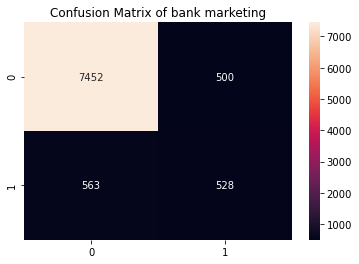

 TestAccuracy
0.8824505142098861


In [43]:
MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_CORR, train_labels)

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_CORR)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_CORR)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))

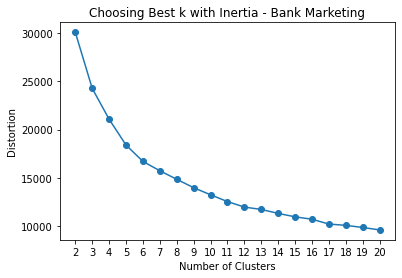

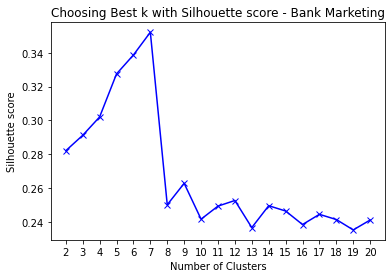

For n_clusters = 2 The average silhouette_score is : 0.28203475950272155
For n_clusters = 3 The average silhouette_score is : 0.29116193202069307
For n_clusters = 4 The average silhouette_score is : 0.30203319028230297
For n_clusters = 5 The average silhouette_score is : 0.32751642499972283
For n_clusters = 6 The average silhouette_score is : 0.3387385757165131
For n_clusters = 7 The average silhouette_score is : 0.35220418571686196
For n_clusters = 8 The average silhouette_score is : 0.25003290800856687
For n_clusters = 9 The average silhouette_score is : 0.26271956405142716
For n_clusters = 10 The average silhouette_score is : 0.24149802086170866
For n_clusters = 11 The average silhouette_score is : 0.2492292231288176
For n_clusters = 12 The average silhouette_score is : 0.25254701286991754
For n_clusters = 13 The average silhouette_score is : 0.2365019218491028
For n_clusters = 14 The average silhouette_score is : 0.24946615504738198
For n_clusters = 15 The average silhouette_score 

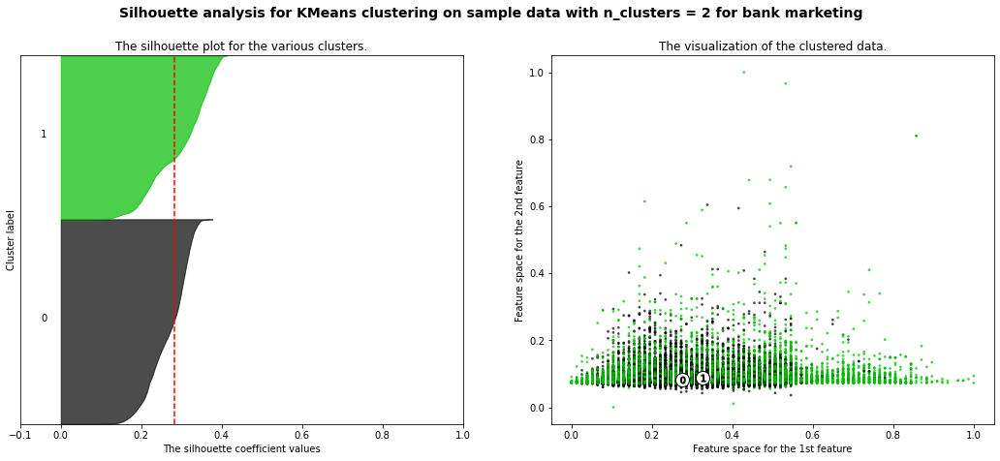

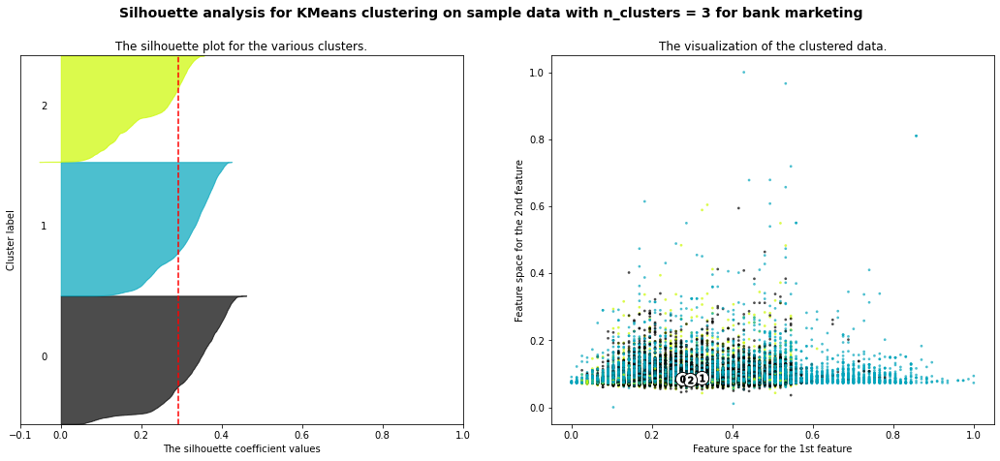

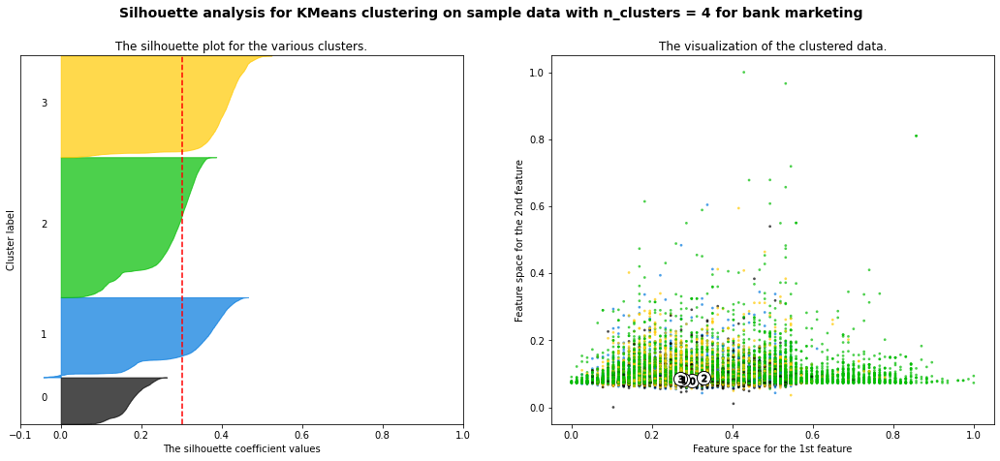

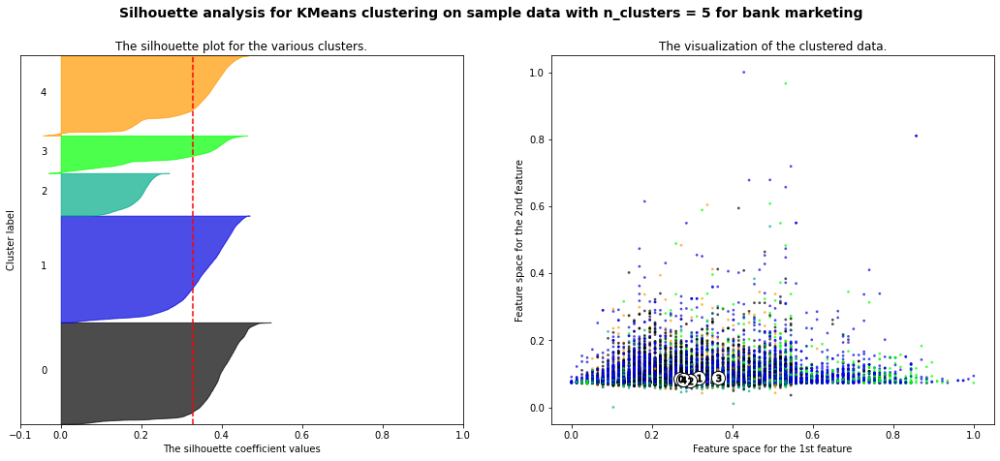

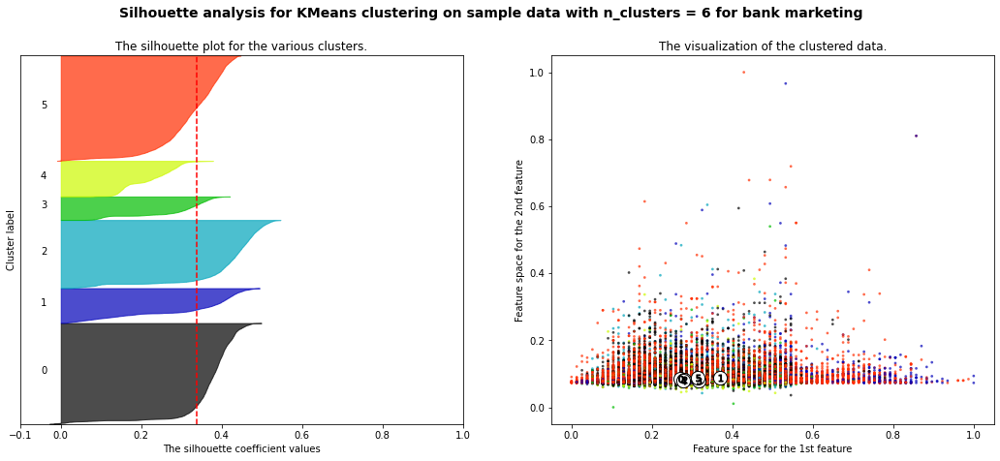

...

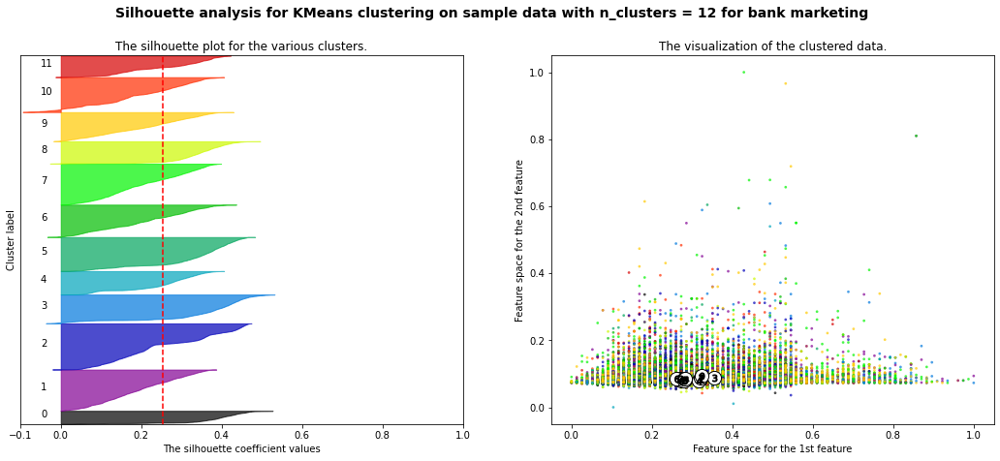

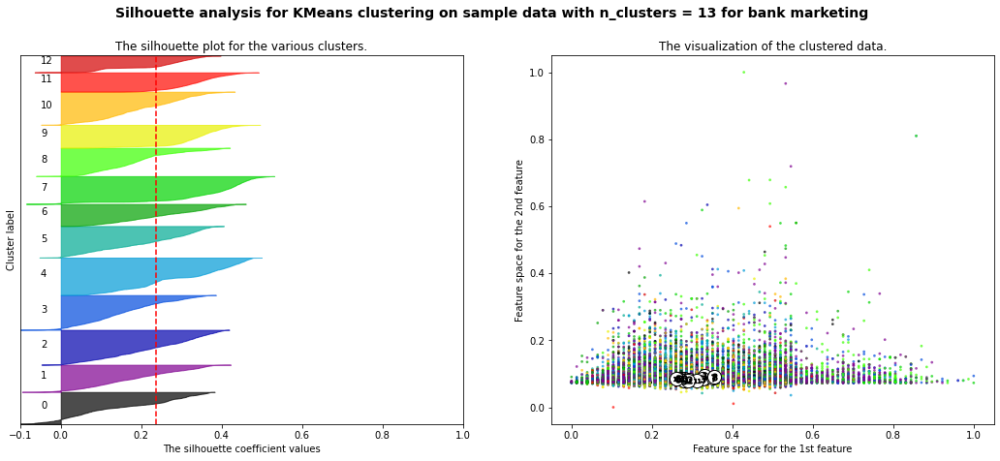

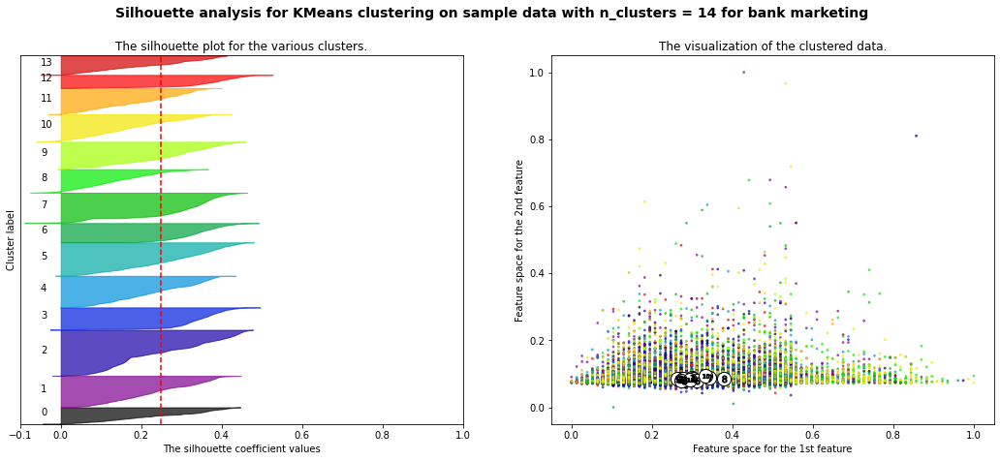

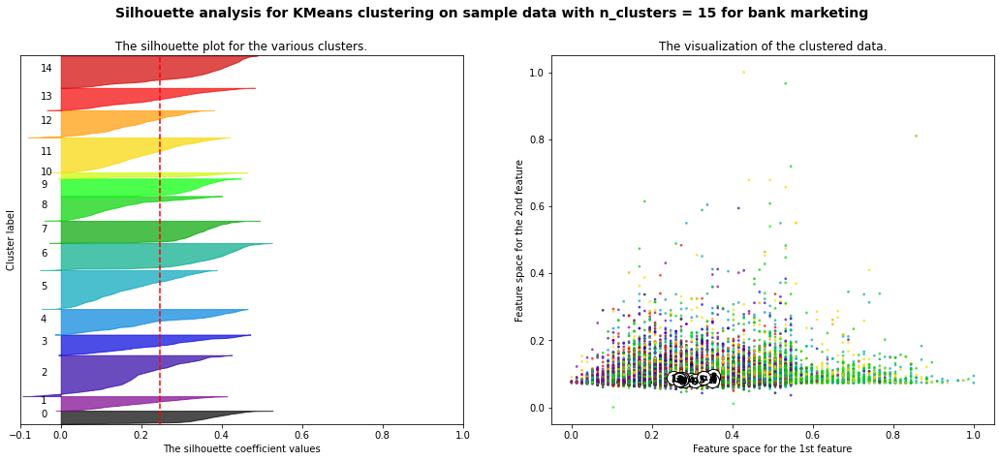

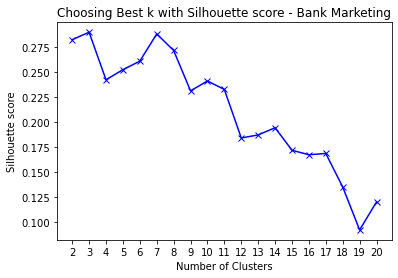

For n_clusters = 2 The average silhouette_score is : 0.28203475950272155
For n_clusters = 3 The average silhouette_score is : 0.2894967318573675
For n_clusters = 4 The average silhouette_score is : 0.24198332586736335
For n_clusters = 5 The average silhouette_score is : 0.25204721446750455
For n_clusters = 6 The average silhouette_score is : 0.2605680031719504
For n_clusters = 7 The average silhouette_score is : 0.28778848161241855
For n_clusters = 8 The average silhouette_score is : 0.27130273556443935
For n_clusters = 9 The average silhouette_score is : 0.23092333425079511
For n_clusters = 10 The average silhouette_score is : 0.24076895498390125
For n_clusters = 11 The average silhouette_score is : 0.23228974770448527
For n_clusters = 12 The average silhouette_score is : 0.18379753675020186
For n_clusters = 13 The average silhouette_score is : 0.1868309093655233
For n_clusters = 14 The average silhouette_score is : 0.19403046476745772
For n_clusters = 15 The average silhouette_score 

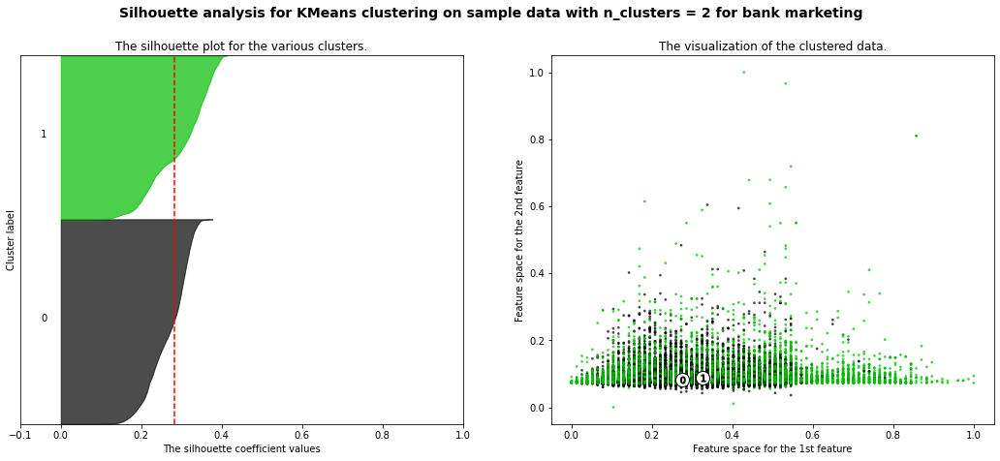

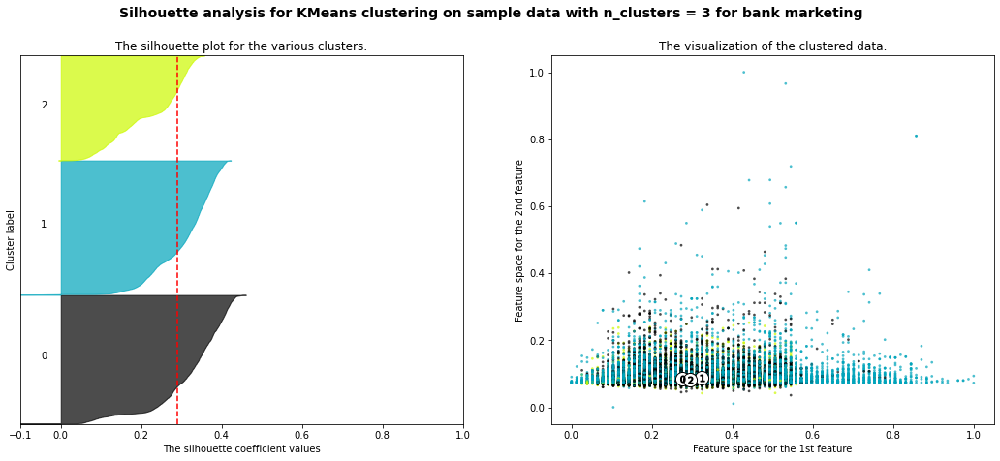

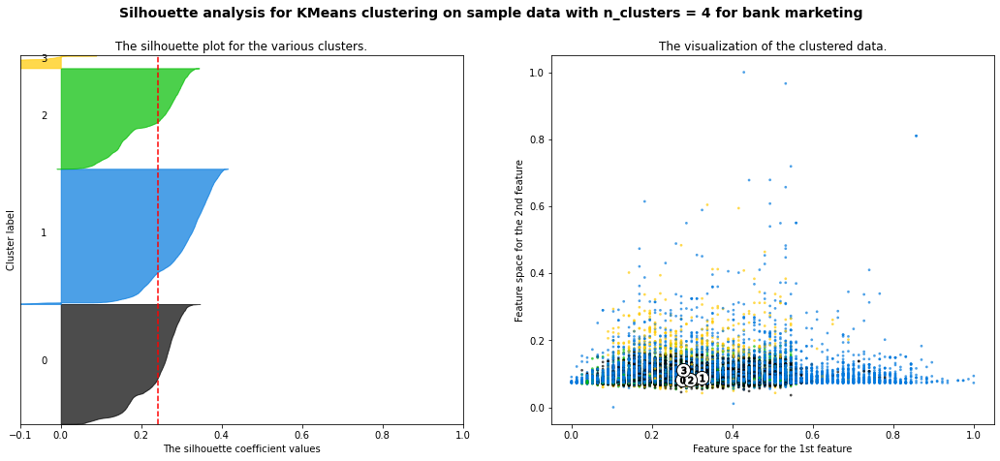

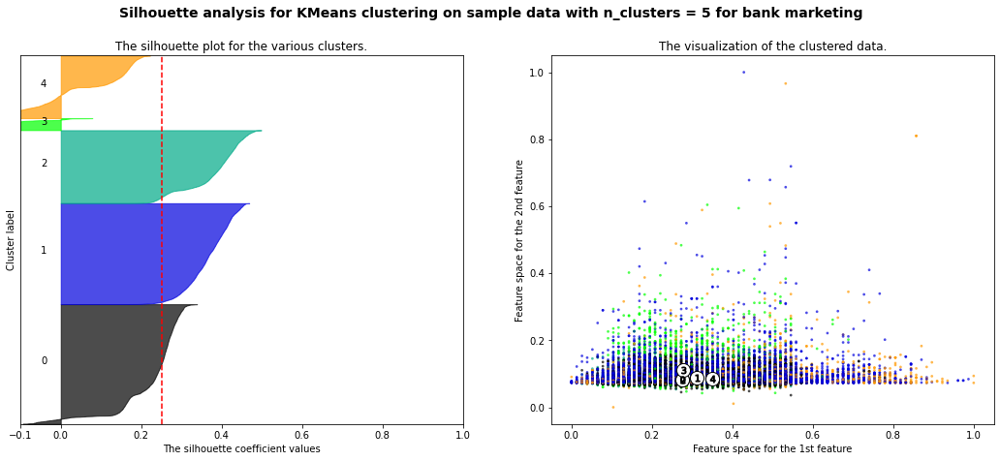

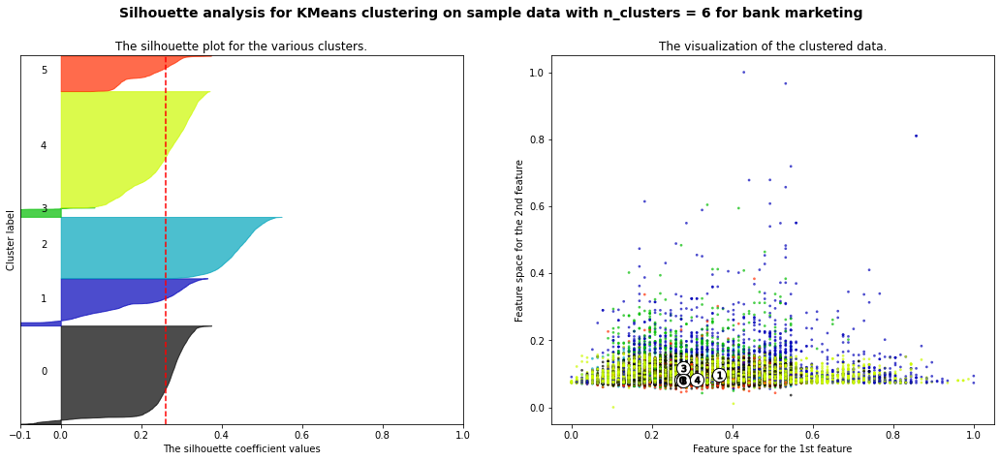

...

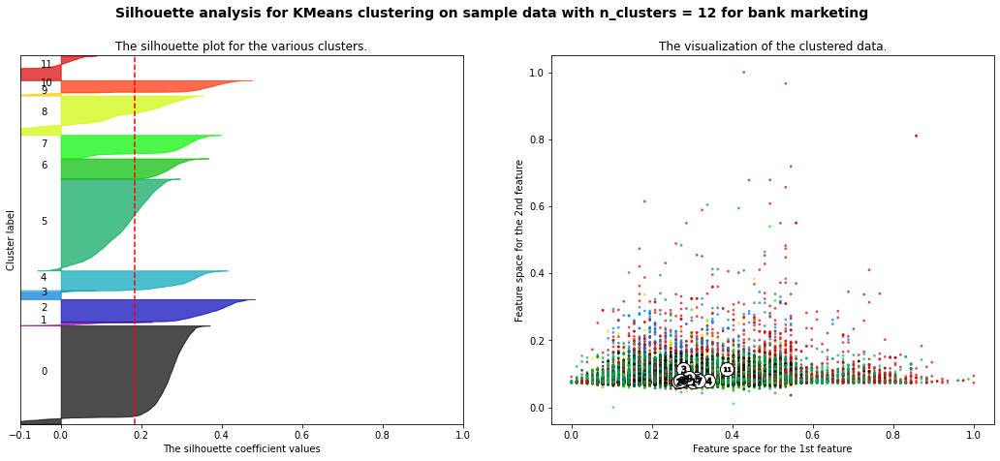

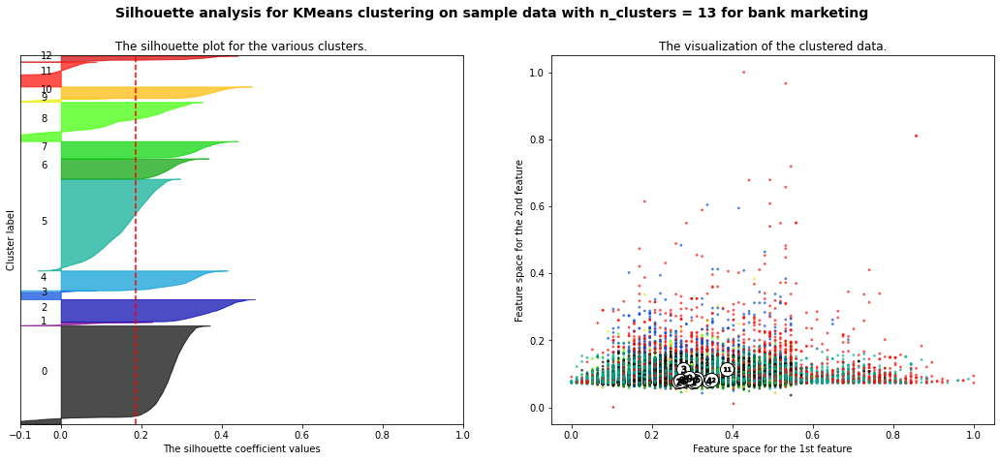

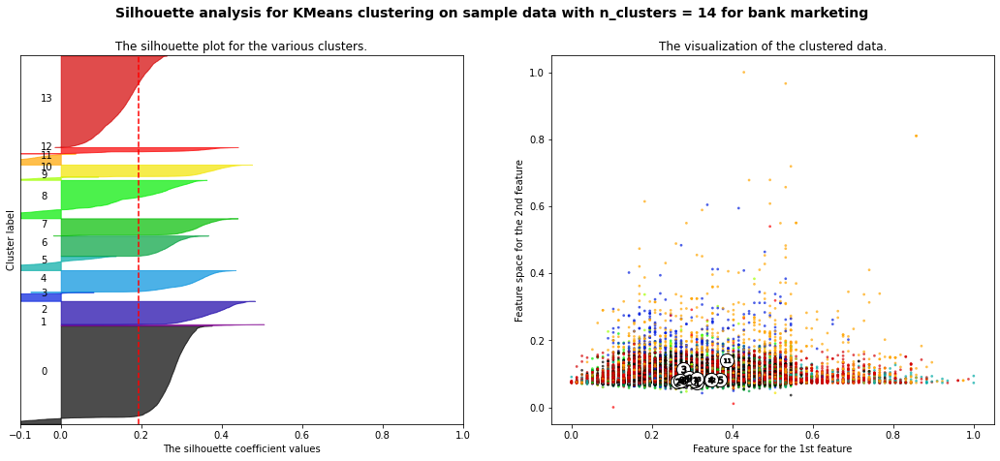

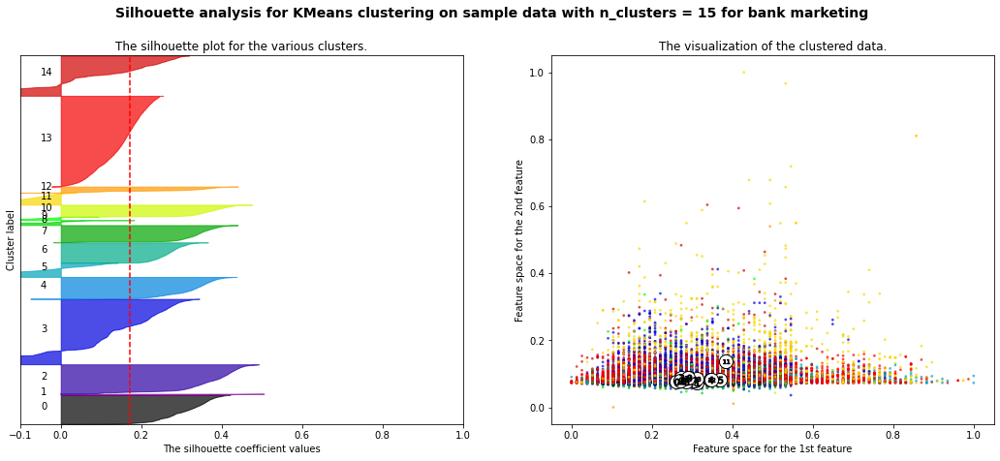

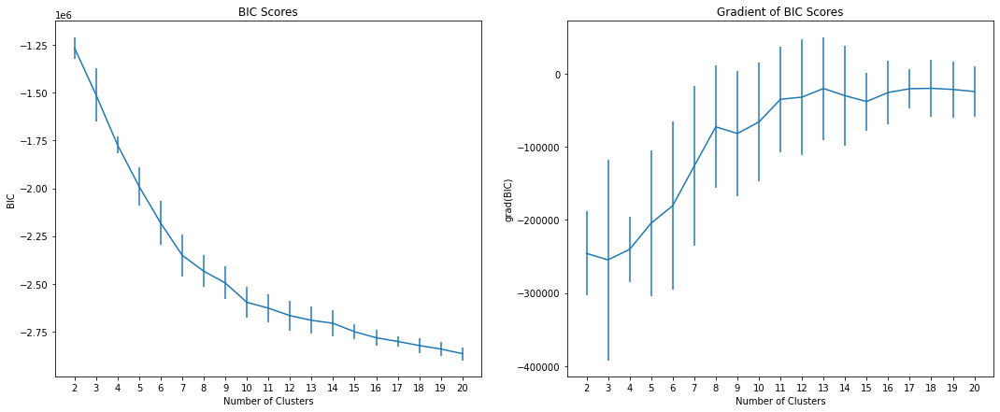

In [44]:
## redo clustering after correlation filter
distortion(corr_result, 21, KMeans)
silhoutte(corr_result, 21, KMeans)
silhoutte_plot(corr_result, 16, KMeans)
silhoutte(corr_result, 21, GaussianMixture)
silhoutte_plot(corr_result, 16, GaussianMixture)
EM_BIC(corr_result, 21)

0.8832862827123391
0.6801918868850131


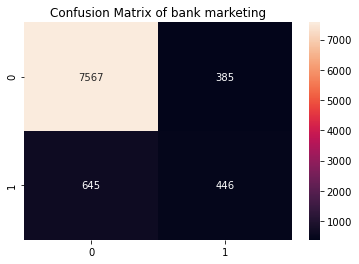

 TestAccuracy
0.8860997456596262


In [46]:
## choose 7 cluster using KMEAN for correlation filter, add as another feature and rerun neural net
clf=KMeans(7, random_state=42).fit(corr_result) 
cluster_labels=clf.predict(corr_result)
cluster_labels = np.reshape(cluster_labels, (-1, 1))

scaler = MinMaxScaler()
cluster_labels = scaler.fit_transform(cluster_labels)

corr_result =np.hstack((corr_result, cluster_labels))


train_features_CORR, test_features_CORR, train_labels, test_labels = train_test_split(corr_result, labels_np, test_size = 0.20, 
                                                                            random_state = 42)

## rerun NN after corrlation filter and clusteriong

MLPclf = MLPClassifier(activation='relu', hidden_layer_sizes= (100, 80, 60, 40, 20), learning_rate_init=0.001, solver='adam', max_iter = 1000)
MLPclf.fit(train_features_CORR, train_labels)

## calculate AUC for training data and testing data
y_pred = MLPclf.predict(train_features_CORR)
y_pred = pd.Series(y_pred)
train_labels_series = pd.Series(train_labels)

y_pred = y_pred.map({'yes': 1, 'no': 0}).astype(int)
train_labels_series = train_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr,tpr,threshold = metrics.roc_curve(train_labels_series, y_pred, pos_label = 1)
print(metrics.auc(fpr,tpr))



## test performance
test_pred_mlp = MLPclf.predict(test_features_CORR)

test_pred_mlp_series = pd.Series(test_pred_mlp)
test_labels_series = pd.Series(test_labels)

test_pred_mlp_series = test_pred_mlp_series.map({'yes': 1, 'no': 0}).astype(int)
test_labels_series = test_labels_series.map({'yes': 1, 'no': 0}).astype(int)

fpr2,tpr2,_ = metrics.roc_curve(test_labels_series, test_pred_mlp_series, pos_label = 1)
print(metrics.auc(fpr2,tpr2))

#get the confusion matrix
confusion_matrix = metrics.confusion_matrix(test_labels,  
                                            test_pred_mlp)
#turn this into a dataframe
matrix_confusion = pd.DataFrame(confusion_matrix)


ax = plt.axes()
sns.heatmap(matrix_confusion,annot=True, annot_kws={"size": 10},fmt="d", ax=ax)
ax.set_title("Confusion Matrix of bank marketing")
plt.show()

print(' TestAccuracy')
print(metrics.accuracy_score(test_labels, test_pred_mlp))